# 1 Preprocess and analyst data

In [89]:
import pandas as pd

In [90]:
df = pd.read_csv('processed.cleveland.csv')

In [91]:
df.head()

,63.0,1.0,1.0.1,145.0,233.0,1.0.2,2.0,150.0,0.0,2.3,3.0,0.0.1,6.0,0
0,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2
1,67.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,7.0,1
2,37.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,3.0,0
3,41.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,3.0,0
4,56.0,1.0,2.0,120.0,236.0,0.0,0.0,178.0,0.0,0.8,1.0,0.0,3.0,0


In [92]:
df.shape

(302, 14)

In [93]:
columns_names = ['age','sex','cp','trestbps','chol','fbs','restecg','thalach','exang','oldpeak','slope','ca','thal','num']
df.columns = columns_names

In [94]:
df.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num
0,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2
1,67.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,7.0,1
2,37.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,3.0,0
3,41.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,3.0,0
4,56.0,1.0,2.0,120.0,236.0,0.0,0.0,178.0,0.0,0.8,1.0,0.0,3.0,0


In [97]:
print(df.thal.value_counts())
print(df.ca.value_counts())
df['thal'][df['thal'] == '?'] = 3
df['ca'][df['ca'] == '?'] = 0
df['thal'] = df['thal'].astype(float, errors = 'raise')
df['ca'] = df['ca'].astype(float, errors = 'raise')
print(df.thal.value_counts())
print(df.ca.value_counts())
df.dtypes

3.0    168
7.0    117
6.0     17
Name: thal, dtype: int64
0.0    178
1.0     66
2.0     38
3.0     20
Name: ca, dtype: int64
3.0    168
7.0    117
6.0     17
Name: thal, dtype: int64
0.0    178
1.0     66
2.0     38
3.0     20
Name: ca, dtype: int64


/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/1324627086.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['thal'][df['thal'] == '?'] = 3
/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/1324627086.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ca'][df['ca'] == '?'] = 0


age         float64
sex         float64
cp          float64
trestbps    float64
chol        float64
fbs         float64
restecg     float64
thalach     float64
exang       float64
oldpeak     float64
slope       float64
ca          float64
thal        float64
num           int64
dtype: object

In [98]:
df.insert(df.shape[1], 'target', 2)
df['target'][df['num'] == 0] = 1
df['target'][df['num'] != 0] = 0


/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/2505221756.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['target'][df['num'] == 0] = 1
/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/2505221756.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['target'][df['num'] != 0] = 0


In [99]:
df.tail()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,target
297,45.0,1.0,1.0,110.0,264.0,0.0,0.0,132.0,0.0,1.2,2.0,0.0,7.0,1,0
298,68.0,1.0,4.0,144.0,193.0,1.0,0.0,141.0,0.0,3.4,2.0,2.0,7.0,2,0
299,57.0,1.0,4.0,130.0,131.0,0.0,0.0,115.0,1.0,1.2,2.0,1.0,7.0,3,0
300,57.0,0.0,2.0,130.0,236.0,0.0,2.0,174.0,0.0,0.0,2.0,1.0,3.0,1,0
301,38.0,1.0,3.0,138.0,175.0,0.0,0.0,173.0,0.0,0.0,1.0,1.0,3.0,0,1


In [100]:
df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,target
0,67.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,3.0,2,0
1,67.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,7.0,1,0
2,37.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,3.0,0,1
3,41.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,3.0,0,1
4,56.0,1.0,2.0,120.0,236.0,0.0,0.0,178.0,0.0,0.8,1.0,0.0,3.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
297,45.0,1.0,1.0,110.0,264.0,0.0,0.0,132.0,0.0,1.2,2.0,0.0,7.0,1,0
298,68.0,1.0,4.0,144.0,193.0,1.0,0.0,141.0,0.0,3.4,2.0,2.0,7.0,2,0
299,57.0,1.0,4.0,130.0,131.0,0.0,0.0,115.0,1.0,1.2,2.0,1.0,7.0,3,0
300,57.0,0.0,2.0,130.0,236.0,0.0,2.0,174.0,0.0,0.0,2.0,1.0,3.0,1,0


In [101]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302 entries, 0 to 301
Data columns (total 15 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       302 non-null    float64
 1   sex       302 non-null    float64
 2   cp        302 non-null    float64
 3   trestbps  302 non-null    float64
 4   chol      302 non-null    float64
 5   fbs       302 non-null    float64
 6   restecg   302 non-null    float64
 7   thalach   302 non-null    float64
 8   exang     302 non-null    float64
 9   oldpeak   302 non-null    float64
 10  slope     302 non-null    float64
 11  ca        302 non-null    float64
 12  thal      302 non-null    float64
 13  num       302 non-null    int64  
 14  target    302 non-null    int64  
dtypes: float64(13), int64(2)
memory usage: 35.5 KB


In [102]:
df.columns

Index(['age', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg', 'thalach',
       'exang', 'oldpeak', 'slope', 'ca', 'thal', 'num', 'target'],
      dtype='object')

In [103]:
df.describe()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,target
count,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000,302.000000
mean,54.410596,0.678808,3.165563,131.645695,246.738411,0.145695,0.986755,149.605960,0.327815,1.035430,1.596026,0.668874,4.718543,0.940397,0.539735
std,9.040163,0.467709,0.953612,17.612202,51.856829,0.353386,0.994916,22.912959,0.470196,1.160723,0.611939,0.934548,1.940199,1.229384,0.499246
min,29.000000,0.000000,1.000000,94.000000,126.000000,0.000000,0.000000,71.000000,0.000000,0.000000,1.000000,0.000000,3.000000,0.000000,0.000000
25%,48.000000,0.000000,3.000000,120.000000,211.000000,0.000000,0.000000,133.250000,0.000000,0.000000,1.000000,0.000000,3.000000,0.000000,0.000000
50%,55.500000,1.000000,3.000000,130.000000,241.500000,0.000000,0.500000,153.000000,0.000000,0.800000,2.000000,0.000000,3.000000,0.000000,1.000000
75%,61.000000,1.000000,4.000000,140.000000,275.000000,0.000000,2.000000,166.000000,1.000000,1.600000,2.000000,1.000000,7.000000,2.000000,1.000000
max,77.000000,1.000000,4.000000,200.000000,564.000000,1.000000,2.000000,202.000000,1.000000,6.200000,3.000000,3.000000,7.000000,4.000000,1.000000


In [104]:
df.isnull().sum()

age         0
sex         0
cp          0
trestbps    0
chol        0
fbs         0
restecg     0
thalach     0
exang       0
oldpeak     0
slope       0
ca          0
thal        0
num         0
target      0
dtype: int64

In [105]:
# !pip install pandas-profiling
# !pip install pandas_profiling
import pandas_profiling

In [106]:
profile = pandas_profiling.ProfileReport(df)

In [16]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
profile.to_file('profile.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [107]:
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

In [108]:
df.corr()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,target
age,1.000000,-0.099925,0.112326,0.283257,0.210120,0.112245,0.146142,-0.394448,0.094065,0.201083,0.156199,0.362196,0.126509,0.225809,-0.226668
sex,-0.099925,1.000000,0.015342,-0.066292,-0.199492,0.042863,0.019386,-0.048740,0.148019,0.099976,0.032671,0.090303,0.379651,0.226601,-0.279518
cp,0.112326,0.015342,1.000000,-0.030717,0.070950,-0.022524,0.075854,-0.337136,0.382394,0.212589,0.171926,0.229474,0.269475,0.405182,-0.411625
trestbps,0.283257,-0.066292,-0.030717,1.000000,0.130924,0.171127,0.144395,-0.045437,0.066627,0.186987,0.112752,0.100836,0.132991,0.159978,-0.153496
chol,0.210120,-0.199492,0.070950,0.130924,1.000000,0.012058,0.172249,-0.003417,0.060755,0.047617,-0.002085,0.118380,0.018946,0.070315,-0.084485
fbs,0.112245,0.042863,-0.022524,0.171127,0.012058,1.000000,0.062202,-0.008067,0.031514,-0.002907,0.042630,0.146564,0.060007,0.065937,-0.032923
restecg,0.146142,0.019386,0.075854,0.144395,0.172249,0.062202,1.000000,-0.083591,0.087432,0.110879,0.127603,0.131045,0.022157,0.186769,-0.172840
thalach,-0.394448,-0.048740,-0.337136,-0.045437,-0.003417,-0.008067,-0.083591,1.000000,-0.378368,-0.343821,-0.389078,-0.262421,-0.274378,-0.415399,0.417701
exang,0.094065,0.148019,0.382394,0.066627,0.060755,0.031514,0.087432,-0.378368,1.000000,0.291536,0.265491,0.141998,0.327262,0.395996,-0.430721
oldpeak,0.201083,0.099976,0.212589,0.186987,0.047617,-0.002907,0.110879,-0.343821,0.291536,1.000000,0.575415,0.301501,0.340942,0.508330,-0.429268


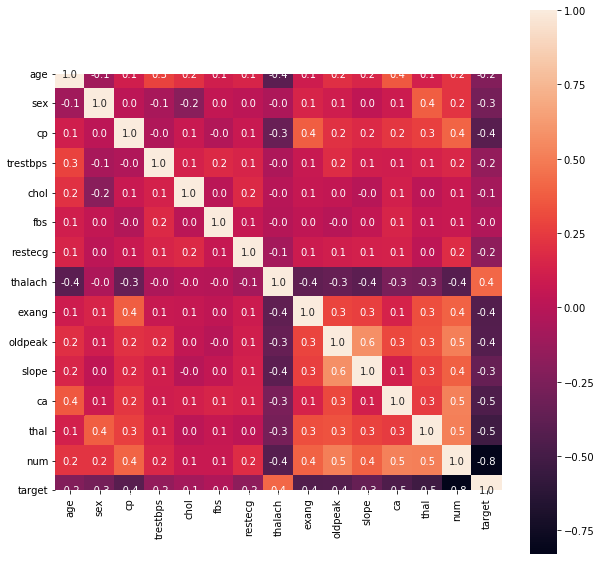

In [109]:
plt.figure(figsize=(10,10))
sns.heatmap(df.corr(),annot = True,fmt = '.1f',square = True)
plt.show()

In [110]:
sns.heatmap?

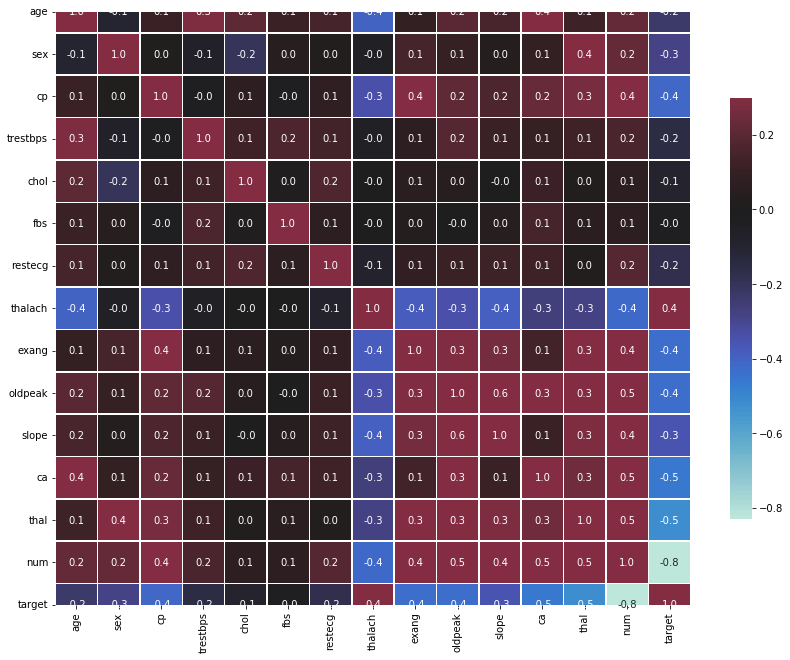

In [111]:
plt.figure(figsize=(12,12))
sns.heatmap(df.corr(), vmax=.3, center=0,
            annot = True,linewidths =.5, cbar_kws ={"shrink" : .5},
            fmt = '.1f',square = True)
plt.tight_layout()
plt.show()

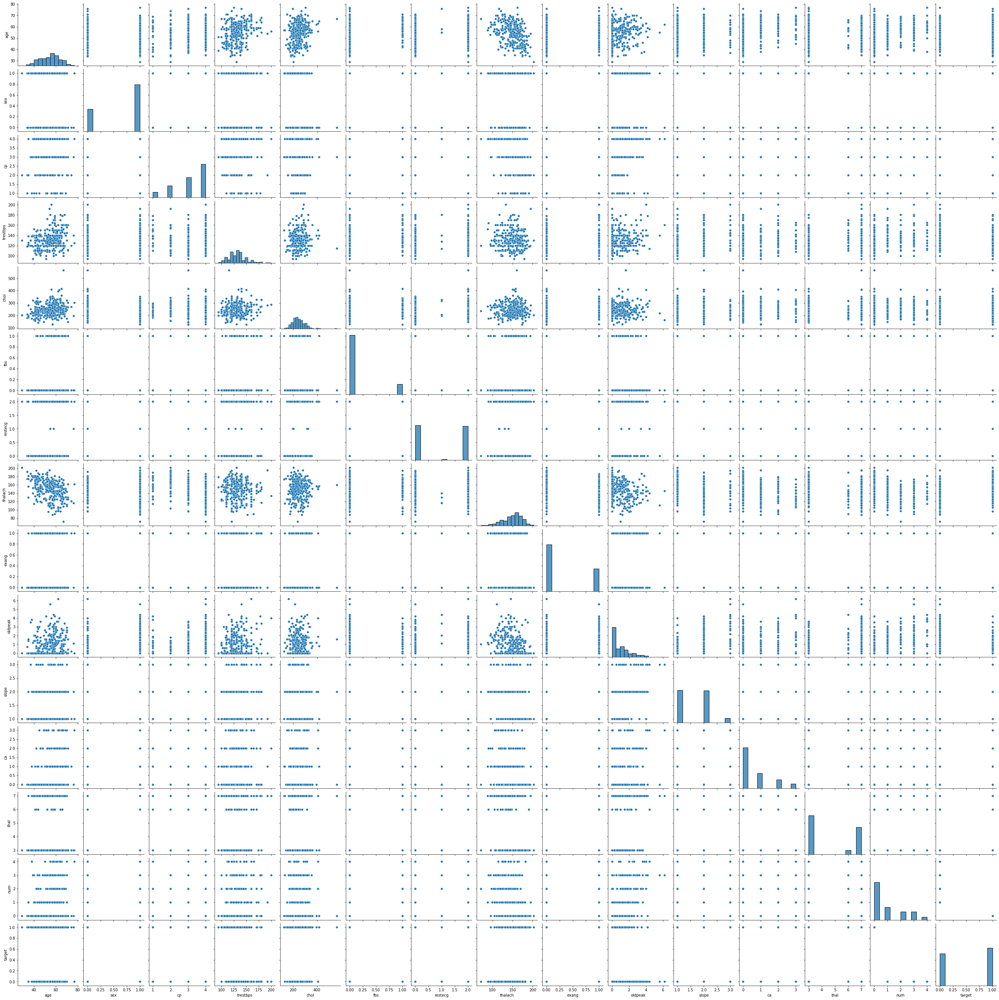

In [112]:
sns.pairplot(df)
plt.show()

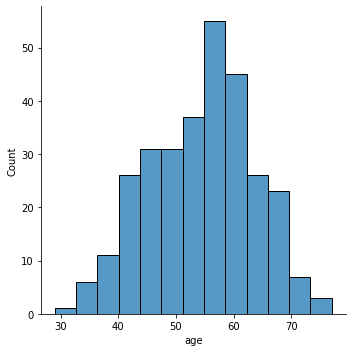

In [113]:
sns.displot(df['age'])
plt.show()

In [114]:
df.age.max()

77.0

In [115]:
df.age.unique()

array([67., 37., 41., 56., 62., 57., 63., 53., 44., 52., 48., 54., 49.,
       64., 58., 60., 50., 66., 43., 40., 69., 59., 42., 55., 61., 65.,
       71., 51., 46., 45., 39., 68., 47., 34., 35., 29., 70., 77., 38.,
       74., 76.])

In [116]:
df.num.value_counts()

0    163
1     55
2     36
3     35
4     13
Name: num, dtype: int64

In [117]:
df.thal.value_counts()

3.0    168
7.0    117
6.0     17
Name: thal, dtype: int64

In [118]:
df.cp.value_counts()

4.0    144
3.0     86
2.0     50
1.0     22
Name: cp, dtype: int64

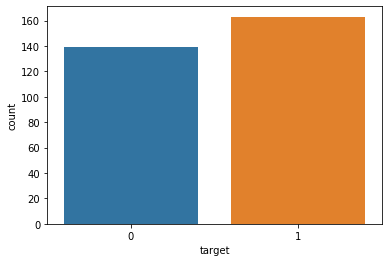

In [119]:
sns.countplot(x ='target',data = df)
plt.show()

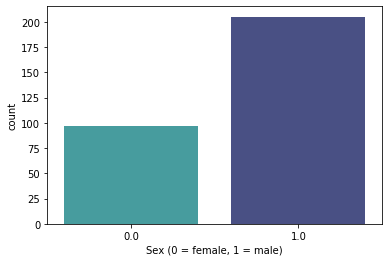

In [120]:
sns.countplot(x = 'sex' ,data = df, palette = "mako_r")
plt.xlabel("Sex (0 = female, 1 = male)")
plt.show()

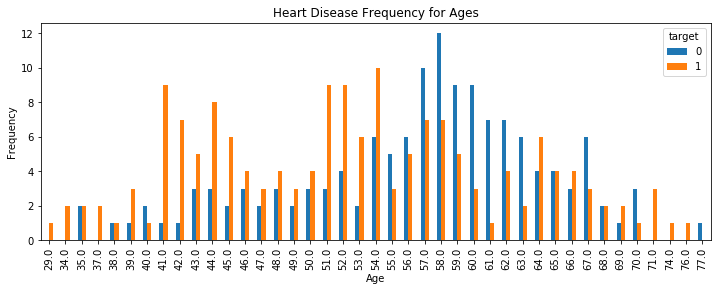

In [121]:
pd.crosstab(df.age, df.target).plot(kind = "bar", figsize = (12,4))
plt.title("Heart Disease Frequency for Ages")
plt.xlabel("Age")
plt.ylabel("Frequency")
# plt.savefig("heartDiseaseAndAges.png")
plt.show()

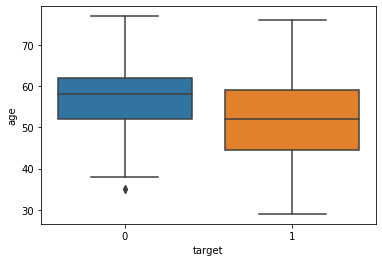

In [122]:
sns.boxplot(x = df['target'],y = df['age'])
plt.show()

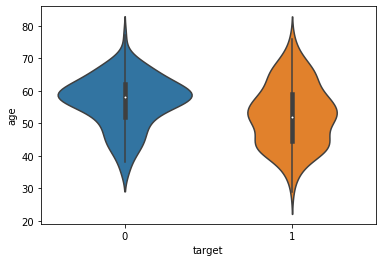

In [123]:
sns.violinplot(x = df['target'],y = df['age'])
plt.show()

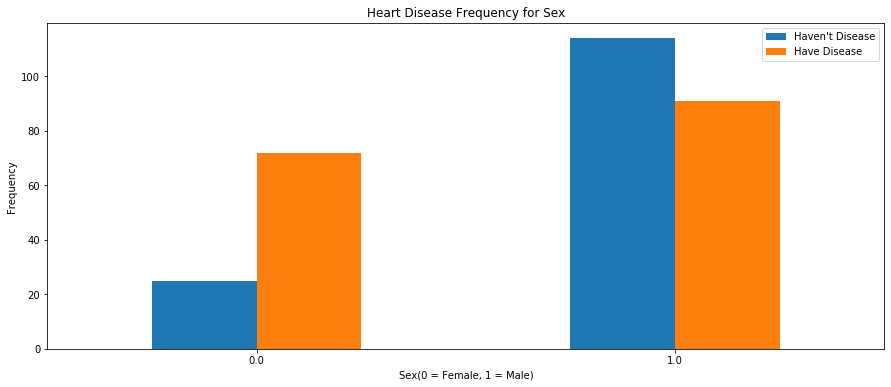

In [124]:
pd.crosstab(df.sex, df.target).plot(kind = "bar", figsize = (15,6))
plt.title("Heart Disease Frequency for Sex")
plt.xlabel("Sex(0 = Female, 1 = Male)")
plt.xticks(rotation = 0)
plt.ylabel("Frequency")
plt.legend(["Haven't Disease",'Have Disease'])
plt.show()

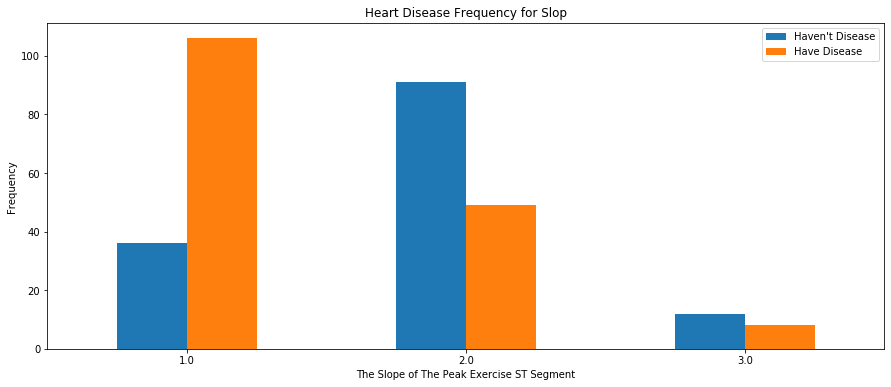

In [125]:
pd.crosstab(df.slope, df.target).plot(kind = "bar", figsize = (15,6))
plt.title("Heart Disease Frequency for Slop")
plt.xlabel("The Slope of The Peak Exercise ST Segment")
plt.xticks(rotation = 0)
plt.ylabel("Frequency")
plt.legend(["Haven't Disease",'Have Disease'])
plt.show()

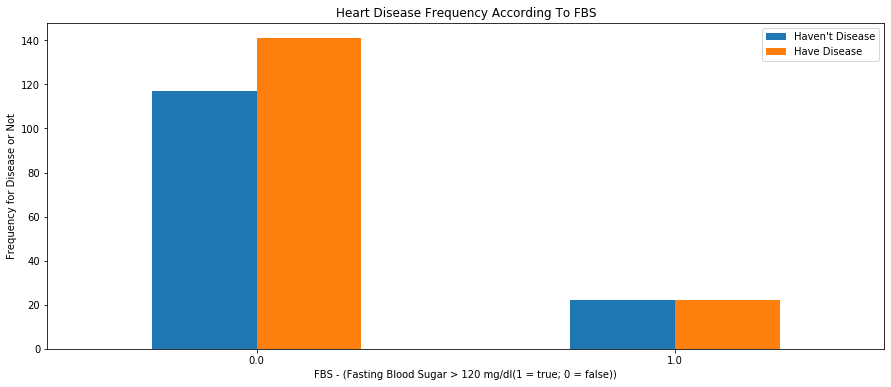

In [126]:
pd.crosstab(df.fbs, df.target).plot(kind = "bar", figsize = (15,6))
plt.title("Heart Disease Frequency According To FBS")
plt.xlabel("FBS - (Fasting Blood Sugar > 120 mg/dl(1 = true; 0 = false))")
plt.xticks(rotation = 0)
plt.ylabel("Frequency for Disease or Not")
plt.legend(["Haven't Disease",'Have Disease'])
plt.show()

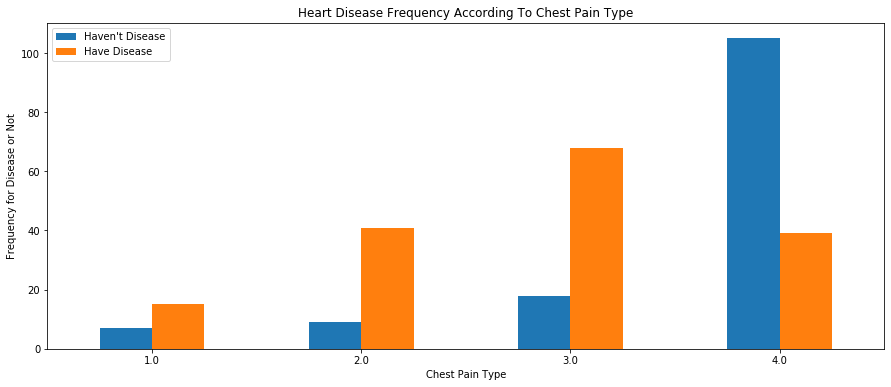

In [127]:
pd.crosstab(df.cp, df.target).plot(kind = "bar", figsize = (15,6))
plt.title("Heart Disease Frequency According To Chest Pain Type")
plt.xlabel("Chest Pain Type")
plt.xticks(rotation = 0)
plt.ylabel("Frequency for Disease or Not")
plt.legend(["Haven't Disease",'Have Disease'])
plt.show()

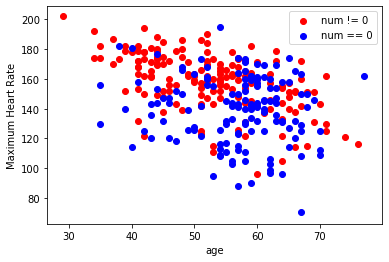

In [128]:
plt.scatter(x = df.age[df.target != 0], y = df.thalach[(df.target != 0)], c = "red")
plt.scatter(x = df.age[df.target == 0], y = df.thalach[(df.target == 0)], c = "blue")
plt.legend(['num != 0', 'num == 0'])
plt.xlabel("age")
plt.ylabel("Maximum Heart Rate")
plt.show()


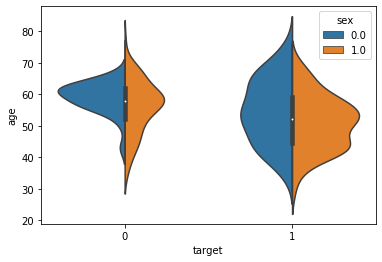

In [129]:
sns.violinplot(x = 'target', y = 'age', hue = 'sex' , data = df , split = True)
plt.show()


In [130]:
df1 = df

In [131]:
df1['sex'][df1['sex'] == 0] = 'female'
df1['sex'][df1['sex'] == 1] = 'male'

df1['cp'][df1['cp'] == 1] = 'typical angima'
df1['cp'][df1['cp'] == 2] = 'atypical angima'
df1['cp'][df1['cp'] == 3] = 'non-angima pain'
df1['cp'][df1['cp'] == 4] = 'asymptotmatic'

df1['fbs'][df1['fbs'] == 0] = 'lower than 120mg/ml'
df1['fbs'][df1['fbs'] == 1] = 'greater than 120mg/ml'

df1['restecg'][df1['restecg'] == 0] = 'normal'
df1['restecg'][df1['restecg'] == 1] = 'ST-T wave  abnormality'
df1['restecg'][df1['restecg'] == 2] = 'left ventricular hypertrophy'

df1['exang'][df1['exang'] == 0] = 'no'
df1['exang'][df1['exang'] == 1] = 'yes'

df1['slope'][df1['slope'] == 3] = 'unslpoing'
df1['slope'][df1['slope'] == 2] = 'flat'
df1['slope'][df1['slope'] == 1] = 'downsloping'


df1['thal'][df1['thal'] == 3] = 'normal'
df1['thal'][df1['thal'] == 6] = 'fixed defect'
df1['thal'][df1['thal'] == 7] = 'reversable defect'


/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/2300857982.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['sex'][df1['sex'] == 0] = 'female'
/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/2300857982.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['cp'][df1['cp'] == 1] = 'typical angima'
/var/folders/n4/bvs20gc55x94bxs_387nynhh0000gn/T/ipykernel_7015/2300857982.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returni

In [132]:
df1.dtypes

age         float64
sex          object
cp           object
trestbps    float64
chol        float64
fbs          object
restecg      object
thalach     float64
exang        object
oldpeak     float64
slope        object
ca          float64
thal         object
num           int64
target        int64
dtype: object

In [317]:
df1.head()

,age,trestbps,chol,thalach,oldpeak,ca,num,target,sex_female,sex_male,...,restecg_left ventricular hypertrophy,restecg_normal,exang_no,exang_yes,slope_downsloping,slope_flat,slope_unslpoing,thal_fixed defect,thal_normal,thal_reversable defect
0,67.0,160.0,286.0,108.0,1.5,3.0,2,0,0,1,...,1,0,0,1,0,1,0,0,1,0
1,67.0,120.0,229.0,129.0,2.6,2.0,1,0,0,1,...,1,0,0,1,0,1,0,0,0,1
2,37.0,130.0,250.0,187.0,3.5,0.0,0,1,0,1,...,0,1,1,0,0,0,1,0,1,0
3,41.0,130.0,204.0,172.0,1.4,0.0,0,1,1,0,...,1,0,1,0,1,0,0,0,1,0
4,56.0,120.0,236.0,178.0,0.8,0.0,0,1,0,1,...,0,1,1,0,1,0,0,0,1,0


In [318]:
df1 = pd.get_dummies(df1)

In [556]:
df1.columns
df1.rename(columns={'restecg_ST-T wave  abnormality': 'restecg_ST-T wave abnormality'}, inplace=True)
df1.columns
print(df1.columns)

Index(['age', 'trestbps', 'chol', 'thalach', 'oldpeak', 'ca', 'num', 'target',
       'sex_female', 'sex_male', 'cp_asymptotmatic', 'cp_atypical angima',
       'cp_non-angima pain', 'cp_typical angima', 'fbs_greater than 120mg/ml',
       'fbs_lower than 120mg/ml', 'restecg_ST-T wave abnormality',
       'restecg_left ventricular hypertrophy', 'restecg_normal', 'exang_no',
       'exang_yes', 'slope_downsloping', 'slope_flat', 'slope_unslpoing',
       'thal_fixed defect', 'thal_normal', 'thal_reversable defect'],
      dtype='object')


In [136]:
df1.head()
df.thal.value_counts()

normal               168
reversable defect    117
fixed defect          17
Name: thal, dtype: int64

In [137]:
df1.to_csv("process_heart2.csv",index = False)

In [138]:
# !pip install pdpbox

# from matplotlib.patches import Patch
# !conda install -c conda-forge pdpbox
from pdpbox import pdp, get_dataset, info_plots


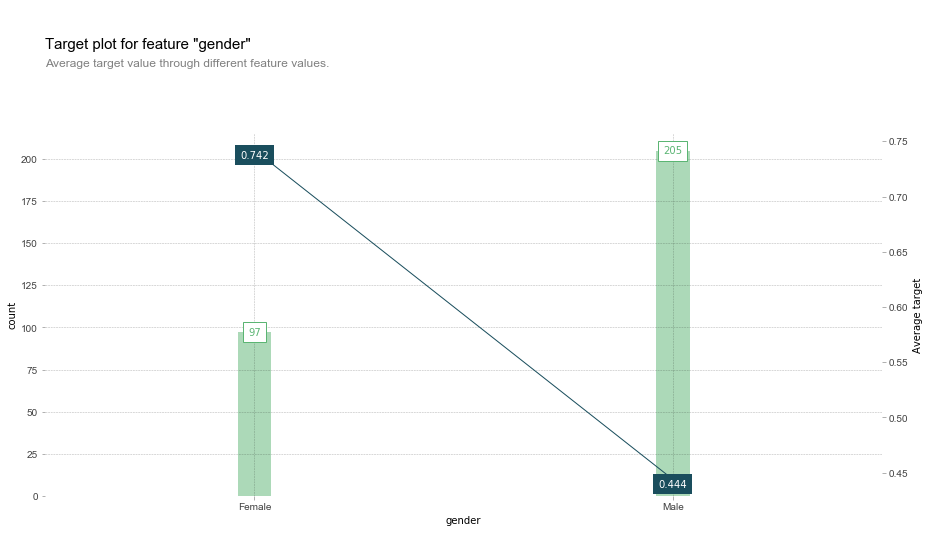

In [139]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'sex_male', feature_name = 'gender', target = ['target']
)
_ = axes['bar_ax'].set_xticklabels(['Female', 'Male'])

In [140]:
summary_df

,x,display_column,count,target
0,0,sex_male_0,97,0.742268
1,1,sex_male_1,205,0.443902


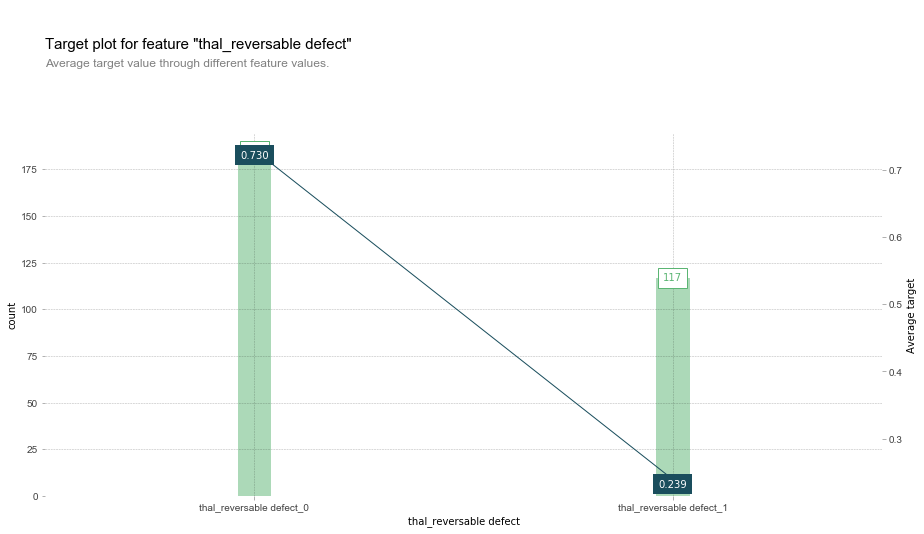

In [141]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'thal_reversable defect', feature_name = 'thal_reversable defect', target = ['target']
)


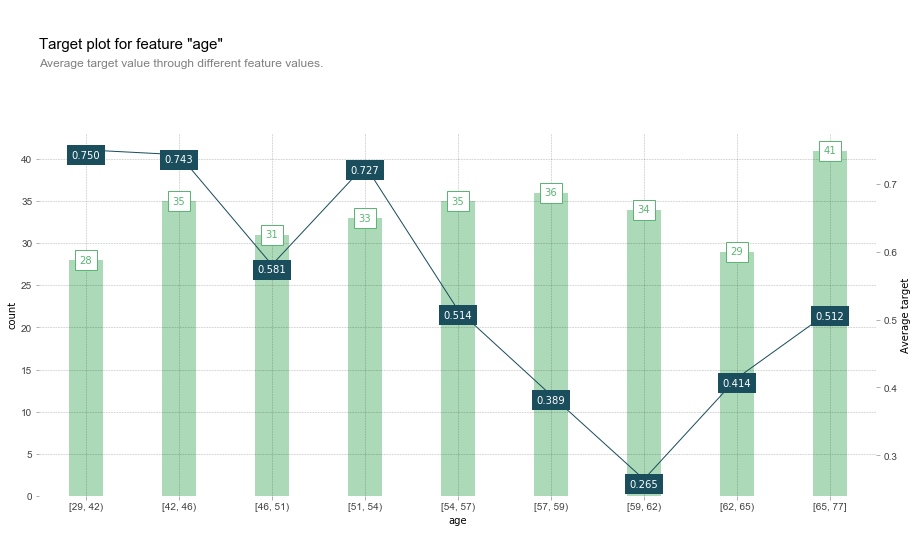

In [142]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'age', feature_name = 'age', target = ['target']
)


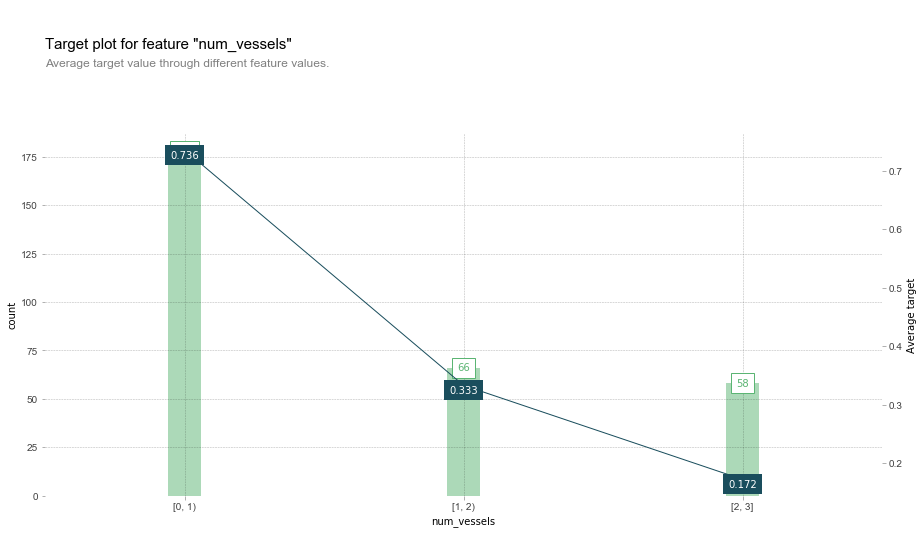

In [144]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'ca', feature_name = 'num_vessels', target = ['target']
)


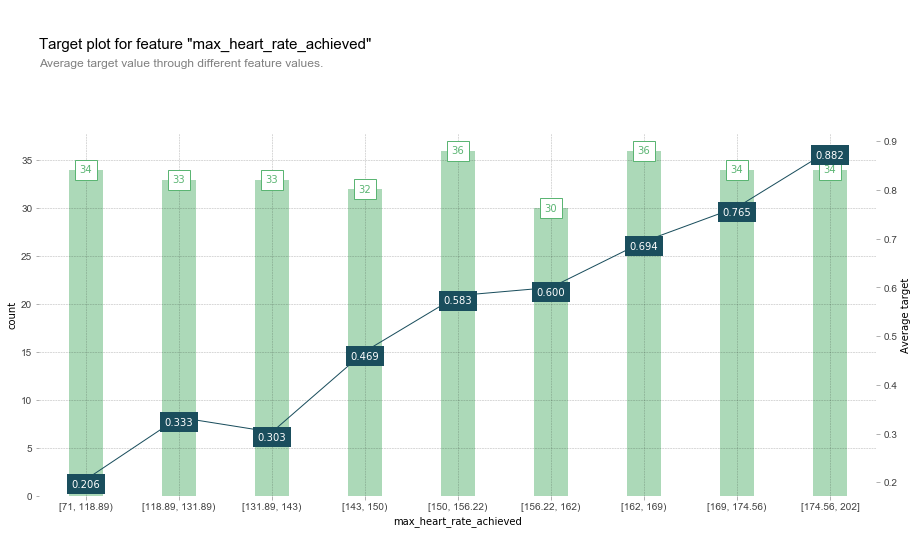

In [148]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'thalach', feature_name = 'max_heart_rate_achieved', target = ['target']
)


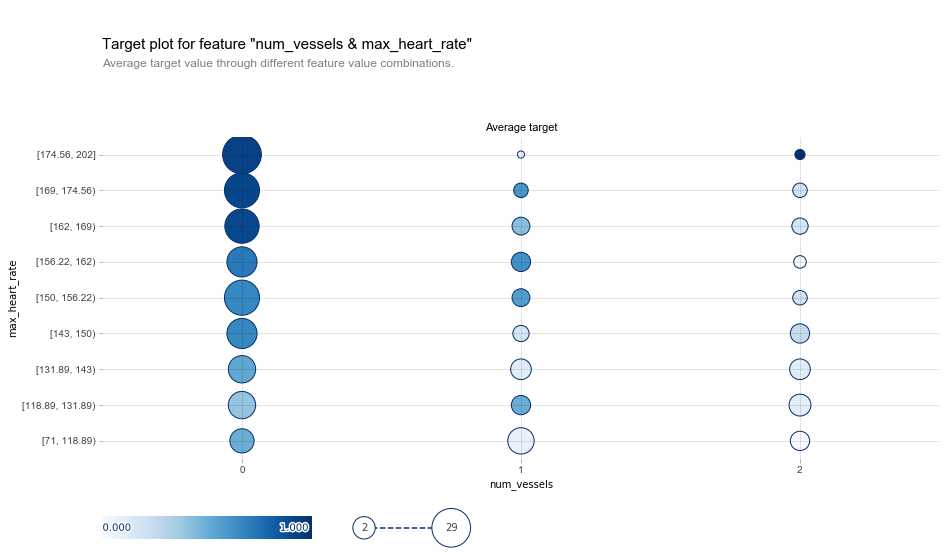

In [153]:
feat_name1 = 'ca'
feat_name2 = "thalach"
nick_name1 = 'num_vessels'
nick_name2 = 'max_heart_rate'

fig, axes, summary_df = info_plots.target_plot_interact(
    df = df1, features = [feat_name1,feat_name2], feature_names = [nick_name1, nick_name2], target = 'target'
)
axes['value_ax'].set_xticklabels(['0','1','2'])
plt.show()

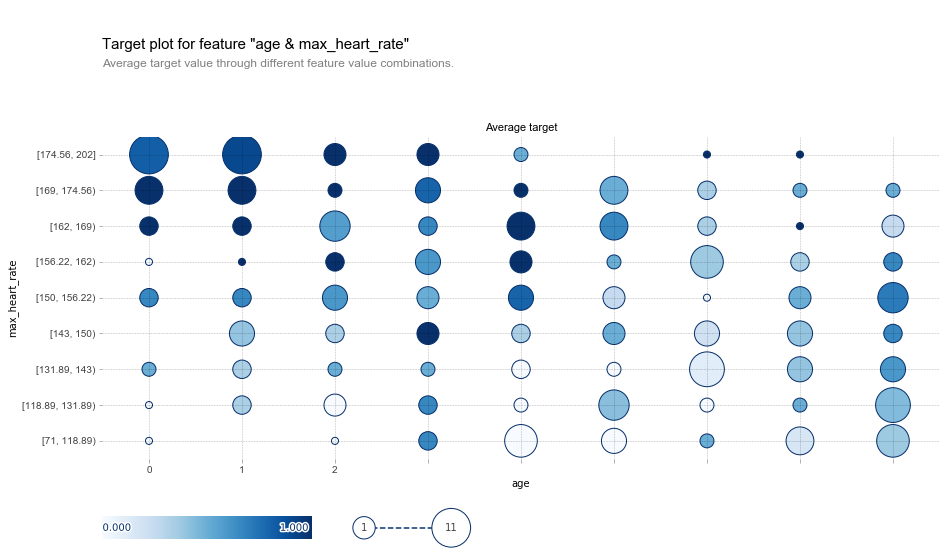

In [155]:
feat_name1 = 'age'
feat_name2 = "thalach"
nick_name1 = 'age'
nick_name2 = 'max_heart_rate'

fig, axes, summary_df = info_plots.target_plot_interact(
    df = df1, features = [feat_name1,feat_name2], feature_names = [nick_name1, nick_name2], target = 'target'
)
axes['value_ax'].set_xticklabels(['0','1','2'])
plt.show()

# 2 Buid and train model                     

In [557]:
X = df1.drop('target',axis = 1)
X = X.drop('num',axis = 1)

In [558]:
X.shape

(302, 25)

In [559]:
y = df['target']

In [560]:
y.shape

(302,)

In [561]:
sum(y == 1)

163

In [562]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y ,test_size=0.2, random_state=10)

In [563]:
X_train.shape

(241, 25)

In [564]:
X_test.shape

(61, 25)

In [565]:
y_train.shape


(241,)

In [566]:
y_test.shape

(61,)

In [567]:
X_test.head()

,age,trestbps,chol,thalach,oldpeak,ca,sex_female,sex_male,cp_asymptotmatic,cp_atypical angima,...,restecg_left ventricular hypertrophy,restecg_normal,exang_no,exang_yes,slope_downsloping,slope_flat,slope_unslpoing,thal_fixed defect,thal_normal,thal_reversable defect
204,45.0,142.0,309.0,147.0,0.0,3.0,0,1,1,0,...,1,0,0,1,0,1,0,0,0,1
154,70.0,130.0,322.0,109.0,2.4,3.0,0,1,1,0,...,1,0,1,0,0,1,0,0,1,0
228,66.0,112.0,212.0,132.0,0.1,1.0,0,1,1,0,...,1,0,0,1,1,0,0,0,1,0
126,54.0,110.0,239.0,126.0,2.8,1.0,0,1,1,0,...,0,1,0,1,0,1,0,0,0,1
183,60.0,158.0,305.0,161.0,0.0,0.0,1,0,1,0,...,1,0,1,0,1,0,0,0,1,0


In [568]:
from sklearn.ensemble import RandomForestClassifier

In [569]:
RandomForestClassifier?

In [570]:
model = RandomForestClassifier(max_depth = 5, n_estimators=100, random_state=5)
model.fit(X_train, y_train)

RandomForestClassifier(max_depth=5, random_state=5)

In [571]:
len(model.estimators_)

100

In [572]:
estimator = model.estimators_[7]

In [573]:
estimator
y.unique()

array([0, 1])

In [574]:
# !conda install python-graphviz
from sklearn.tree import export_graphviz
export_graphviz(estimator, out_file='tree.dot',
               feature_names = X_train.columns,
               class_names = ['no disease','disease'],
               rounded= True, proportion= True,
               label = 'root',
               precision = 2, filled = True)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree.png')

# # import graphviz

# # with open("tree.dot") as f:
# #     dot_graph = f.read()
# # dot = graphviz.Source(dot_graph)
# # dot.view()


In [575]:
import eli5
feature_names = X_train.columns
eli5.show_weights(estimator, feature_names = feature_names.to_list())

Weight,Feature
0.2606,thalach
0.1645,oldpeak
0.1101,ca
0.0861,exang_no
0.0740,cp_asymptotmatic
0.0715,thal_reversable defect
0.0589,cp_non-angima pain
0.0480,trestbps
0.0366,exang_yes
0.0364,sex_female


In [576]:
model.feature_importances_

array([0.05289425, 0.04686443, 0.04665755, 0.10340204, 0.13971488,
       0.11667255, 0.02235072, 0.01857575, 0.09423886, 0.0057383 ,
       0.01959933, 0.01319618, 0.00503042, 0.00488894, 0.00062114,
       0.00913645, 0.01080963, 0.0227859 , 0.02673338, 0.05246386,
       0.02402246, 0.00298482, 0.00429142, 0.10487399, 0.05145274])

In [577]:
import numpy as np
print("feature sort: ")
feature_names = X_test.columns
feature_importances = model.feature_importances_
indices = np.argsort(feature_importances)[::-1]

for index in indices:
    print("feature %s (%f)" %(feature_names[index], feature_importances[index]))

feature sort: 
feature oldpeak (0.139715)
feature ca (0.116673)
feature thal_normal (0.104874)
feature thalach (0.103402)
feature cp_asymptotmatic (0.094239)
feature age (0.052894)
feature slope_downsloping (0.052464)
feature thal_reversable defect (0.051453)
feature trestbps (0.046864)
feature chol (0.046658)
feature exang_yes (0.026733)
feature slope_flat (0.024022)
feature exang_no (0.022786)
feature sex_female (0.022351)
feature cp_non-angima pain (0.019599)
feature sex_male (0.018576)
feature cp_typical angima (0.013196)
feature restecg_normal (0.010810)
feature restecg_left ventricular hypertrophy (0.009136)
feature cp_atypical angima (0.005738)
feature fbs_greater than 120mg/ml (0.005030)
feature fbs_lower than 120mg/ml (0.004889)
feature thal_fixed defect (0.004291)
feature slope_unslpoing (0.002985)
feature restecg_ST-T wave abnormality (0.000621)


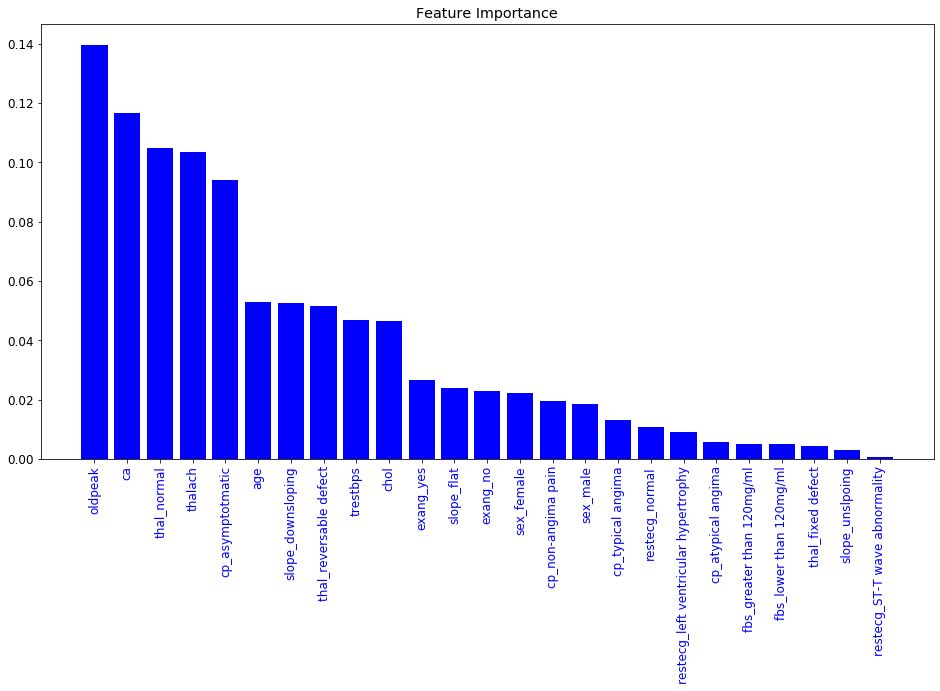

In [578]:
plt.figure(figsize= (16,8))
plt.title("Feature Importance")
plt.bar(range(len(feature_importances)),feature_importances[indices], color = 'b')
plt.xticks(range(len(feature_importances)), np.array(feature_names)[indices], color = 'b', rotation = 90)
plt.show()

# 3 Evaluate model

In [579]:
X_test.shape

(61, 25)

## 3.1 Predict on one sample

In [580]:
X_test.iloc[2]

age                                      66.0
trestbps                                112.0
chol                                    212.0
thalach                                 132.0
oldpeak                                   0.1
ca                                        1.0
sex_female                                0.0
sex_male                                  1.0
cp_asymptotmatic                          1.0
cp_atypical angima                        0.0
cp_non-angima pain                        0.0
cp_typical angima                         0.0
fbs_greater than 120mg/ml                 0.0
fbs_lower than 120mg/ml                   1.0
restecg_ST-T wave abnormality             0.0
restecg_left ventricular hypertrophy      1.0
restecg_normal                            0.0
exang_no                                  0.0
exang_yes                                 1.0
slope_downsloping                         1.0
slope_flat                                0.0
slope_unslpoing                   

In [581]:
test_sample = X_test.iloc[2]

In [582]:
test_sample = np.array(test_sample).reshape(1, -1)

In [583]:
test_sample

array([[6.60e+01, 1.12e+02, 2.12e+02, 1.32e+02, 1.00e-01, 1.00e+00,
        0.00e+00, 1.00e+00, 1.00e+00, 0.00e+00, 0.00e+00, 0.00e+00,
        0.00e+00, 1.00e+00, 0.00e+00, 1.00e+00, 0.00e+00, 0.00e+00,
        1.00e+00, 1.00e+00, 0.00e+00, 0.00e+00, 0.00e+00, 1.00e+00,
        0.00e+00]])

In [584]:
test_sample.shape

(1, 25)

In [585]:
 model.predict(test_sample)

array([0])

In [586]:
model.predict_proba(test_sample)

array([[0.65320997, 0.34679003]])

## 3.2 Predict on test dataset

In [587]:
model.predict(X_test)

array([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1])

In [588]:
model.predict_proba(X_test)

array([[0.77942257, 0.22057743],
       [0.78147969, 0.21852031],
       [0.65320997, 0.34679003],
       [0.94455656, 0.05544344],
       [0.10124241, 0.89875759],
       [0.9517757 , 0.0482243 ],
       [0.84693123, 0.15306877],
       [0.23667876, 0.76332124],
       [0.07963734, 0.92036266],
       [0.12860684, 0.87139316],
       [0.46999572, 0.53000428],
       [0.92868256, 0.07131744],
       [0.78131736, 0.21868264],
       [0.15292147, 0.84707853],
       [0.22558172, 0.77441828],
       [0.07944225, 0.92055775],
       [0.93172087, 0.06827913],
       [0.02729923, 0.97270077],
       [0.12648502, 0.87351498],
       [0.859942  , 0.140058  ],
       [0.26811672, 0.73188328],
       [0.43376431, 0.56623569],
       [0.41085492, 0.58914508],
       [0.98829427, 0.01170573],
       [0.53709122, 0.46290878],
       [0.29553424, 0.70446576],
       [0.19364807, 0.80635193],
       [0.22960742, 0.77039258],
       [0.06077606, 0.93922394],
       [0.94559394, 0.05440606],
       [0.

In [589]:
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test)

In [590]:
y_test

204    0
154    0
228    0
126    0
183    0
      ..
276    1
121    1
186    0
300    0
282    1
Name: target, Length: 61, dtype: int64

## 3.3 Confusion matrix

In [591]:
from sklearn.metrics import confusion_matrix

In [592]:
confusion_matrix?

In [593]:
confusion_matrix_model = confusion_matrix(y_test, y_pred)

In [594]:
confusion_matrix_model

array([[24,  7],
       [ 0, 30]])

In [595]:
import itertools
# def cnf_matrix_plotter(cm, classes):
#     plt.figure(figsize=(6, 6)) 
#     plt.imshow(cm, interpolation = 'nearest', cmap = plt.cm.Oranges,
#                 aspect=1.5)
#     plt.title("Confusion Matrix")
#     plt.colorbar()
#     tick_marks = np.arange(len(classes))
#     plt.xticks(tick_marks, classes, rotation = 45)
#     plt.yticks(tick_marks, classes)
    
#     threshold = cm.max() / 2
#     for i,j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
#         plt.text(j, i, cm[i, j],
#                 color = "white" if cm[i, j] > threshold else "black",
#                 horizontalalignment = 'center',
#                 fontsize = 25)
#     plt.tight_layout()
#     plt.ylabel("True Label")
#     plt.xlabel("Predicted Label")
#     plt.show()

def cnf_matrix_plotter(cm, classes):
    fig, ax = plt.subplots(figsize=(8, 8))
    im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Oranges, aspect=1)
    ax.set_title("Confusion Matrix")
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    threshold = cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        ax.text(j, i, cm[i, j],
                 horizontalalignment='center',
                 color="white" if cm[i, j] > threshold else "black",
                 fontsize=25)

    # Set extent to show all cells within the figure
    ax.set_xlim(-0.5, len(classes)-0.5)
    ax.set_ylim(len(classes)-0.5, -0.5)

    # Add colorbar
    cbar = ax.figure.colorbar(im, ax=ax)
    cbar.ax.set_ylabel('Count', rotation=-90, va="bottom")

    # Add axis labels
    ax.set_ylabel("True Label")
    ax.set_xlabel("Predicted Label")

    plt.show()


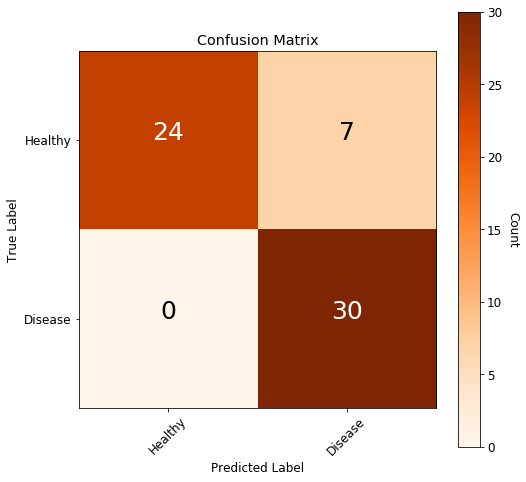

In [596]:
cnf_matrix_plotter(confusion_matrix_model, ['Healthy', 'Disease'])

In [597]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names = ['Healthy', 'Disease']))

              precision    recall  f1-score   support

     Healthy       1.00      0.77      0.87        31
     Disease       0.81      1.00      0.90        30

    accuracy                           0.89        61
   macro avg       0.91      0.89      0.88        61
weighted avg       0.91      0.89      0.88        61



## 3.4 ROC curve

In [598]:
y_pred_quant = model.predict_proba(X_test)[:, 1]

In [599]:
from sklearn.metrics import roc_curve, auc
fpr, tpr, thresholds = roc_curve(y_test, y_pred_quant)

In [600]:
fpr

array([0.        , 0.        , 0.        , 0.06451613, 0.06451613,
       0.09677419, 0.09677419, 0.12903226, 0.12903226, 0.16129032,
       0.16129032, 1.        ])

In [601]:
tpr

array([0.        , 0.03333333, 0.26666667, 0.26666667, 0.4       ,
       0.4       , 0.6       , 0.6       , 0.96666667, 0.96666667,
       1.        , 1.        ])

In [602]:
thresholds

array([1.97270077, 0.97270077, 0.92036266, 0.89875759, 0.87351498,
       0.87139316, 0.80635193, 0.7844207 , 0.58914508, 0.58760894,
       0.56623569, 0.01170573])

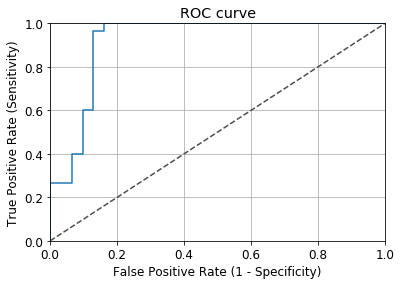

In [603]:
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], ls = "--", c =".3")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.rcParams['font.size'] = 12
plt.title("ROC curve")
plt.xlabel("False Positive Rate (1 - Specificity)")
plt.ylabel("True Positive Rate (Sensitivity)")
plt.grid(True)

In [604]:
auc(fpr,tpr)

0.9193548387096775

In [605]:
from eli5.sklearn import PermutationImportance

perm = PermutationImportance(model, random_state=1).fit(X_test, y_test)
eli5.show_weights(perm, feature_names = X_test.columns.tolist())

Weight,Feature
0.0557 ± 0.0533,cp_asymptotmatic
0.0557 ± 0.0161,ca
0.0361 ± 0.0435,thal_normal
0.0164 ± 0.0207,thal_reversable defect
0.0164 ± 0.0000,restecg_normal
0.0131 ± 0.0131,exang_no
0.0098 ± 0.0161,chol
0.0098 ± 0.0334,sex_female
0.0098 ± 0.0161,restecg_left ventricular hypertrophy
0.0098 ± 0.0572,oldpeak


# 4 Explainability analysis of machine models

## 4.1 PDP Plot

**The PDP plot reflects the influence of a certain feature on the model prediction results as the value changes.**

**Pay attention to comparing the differences between the PDP plot and the prior dataset's distributions of different categories.**

### 4.1.1GENDER

**notice the differences between two plot**

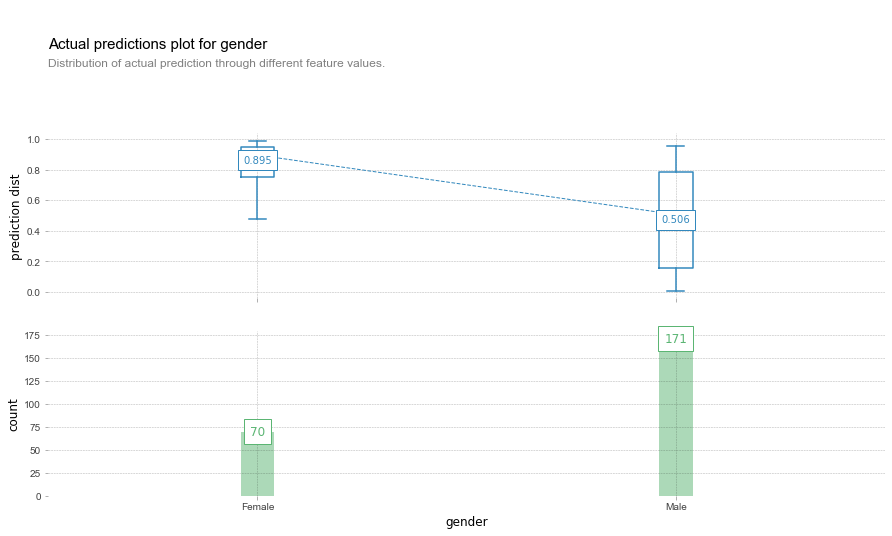

In [606]:
fig, axes, summary_df = info_plots.actual_plot(
    model = model, X = X_train, feature = 'sex_male', feature_name = 'gender', predict_kwds = {}
)
_ = axes['bar_ax'].set_xticklabels(['Female', 'Male'])

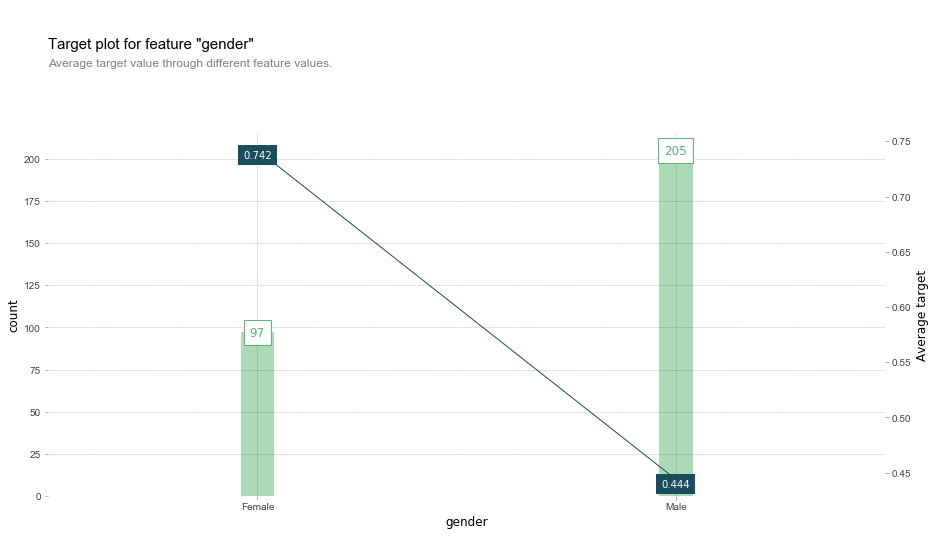

In [607]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'sex_male', feature_name = 'gender', target = ['target']
)
_ = axes['bar_ax'].set_xticklabels(['Female', 'Male'])

### 4.1.2 number of major vessels

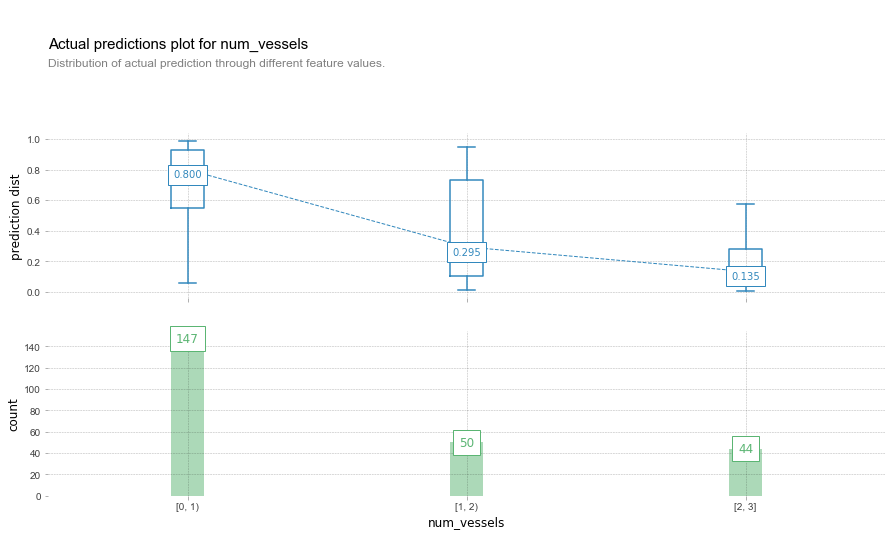

In [608]:
fig, axes, summary_df = info_plots.actual_plot(
    model = model, X = X_train, feature = 'ca', feature_name = 'num_vessels', predict_kwds = {}
)

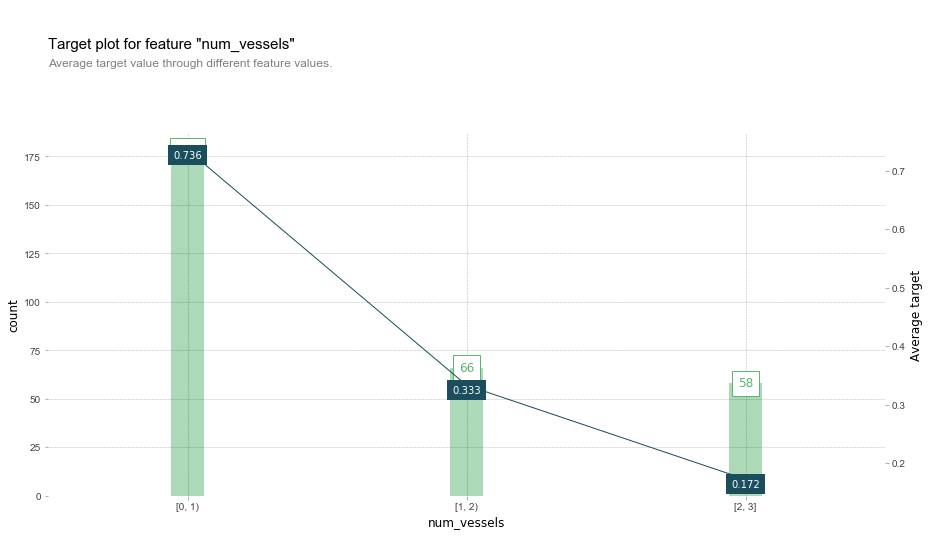

In [609]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'ca', feature_name = 'num_vessels', target = ['target']
)


### 4.1.3 maximum heart rate achieved

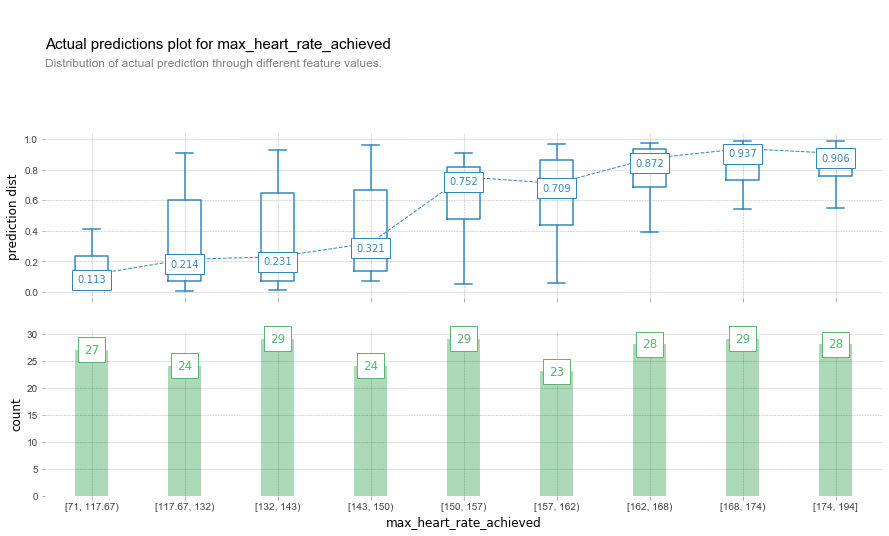

In [610]:
fig, axes, summary_df = info_plots.actual_plot(
    model = model, X = X_train, feature = 'thalach', feature_name = 'max_heart_rate_achieved', predict_kwds = {}
)

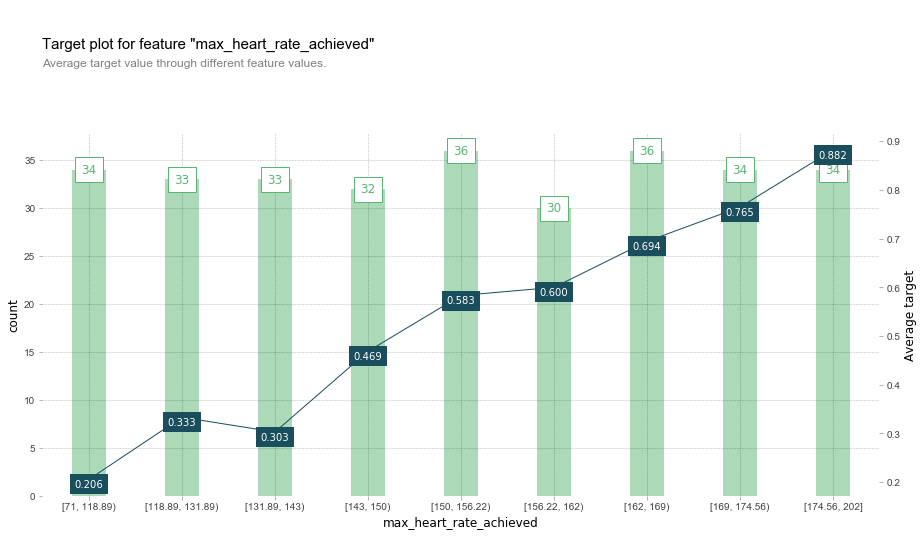

In [611]:
fig, axes, summary_df = info_plots.target_plot(
    df = df1, feature = 'thalach', feature_name = 'max_heart_rate_achieved', target = ['target']
)


## 4.2 ICE Plot
**ICE: display the PDP plot for each individual sample in the test set**

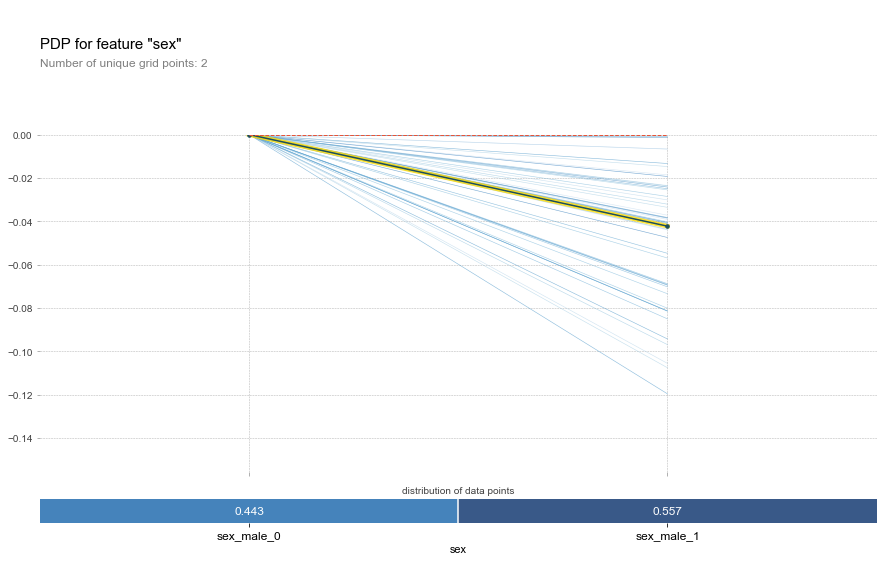

In [612]:
feat_name = 'sex_male'
nick_name = "sex"
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, nick_name, plot_lines=True, frac_to_plot=0.8, plot_pts_dist=True)

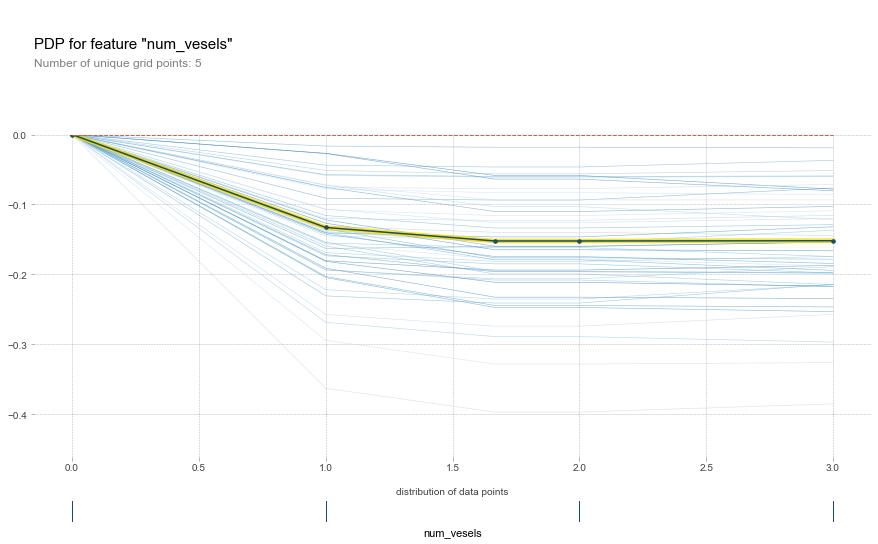

In [613]:
feat_name = 'ca'
nick_name = "num_vesels"
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, nick_name, plot_lines=True, frac_to_plot=0.8, plot_pts_dist=True)

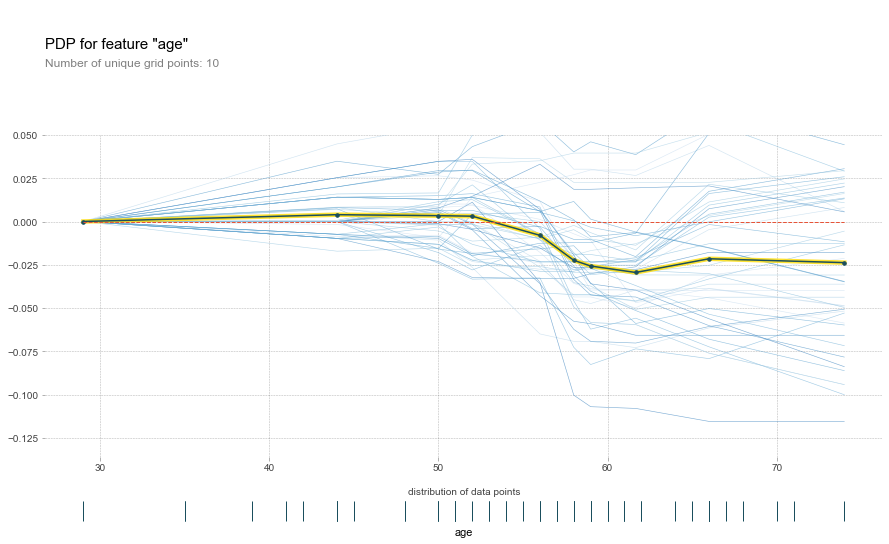

In [614]:
feat_name = 'age'
nick_name = "age"
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, nick_name, plot_lines=True, frac_to_plot=0.8, plot_pts_dist=True)

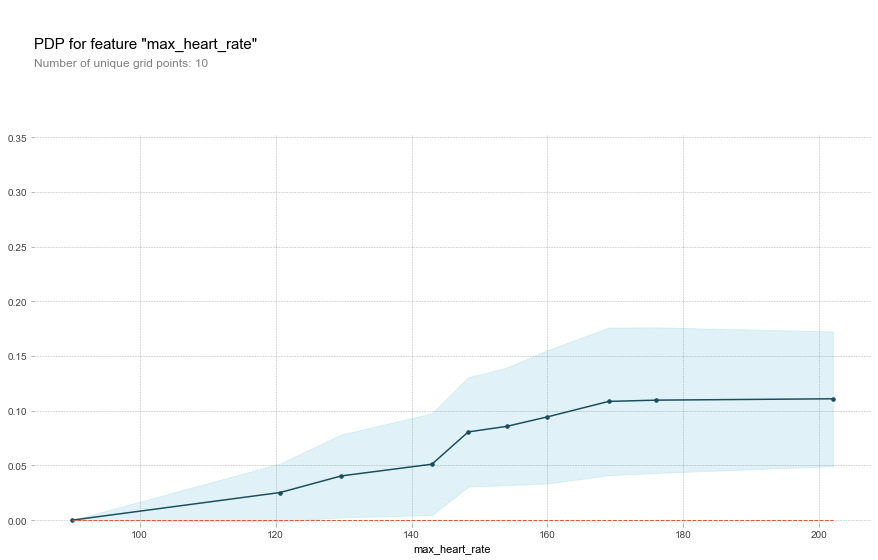

In [615]:
feat_name = 'thalach'
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, 'max_heart_rate')

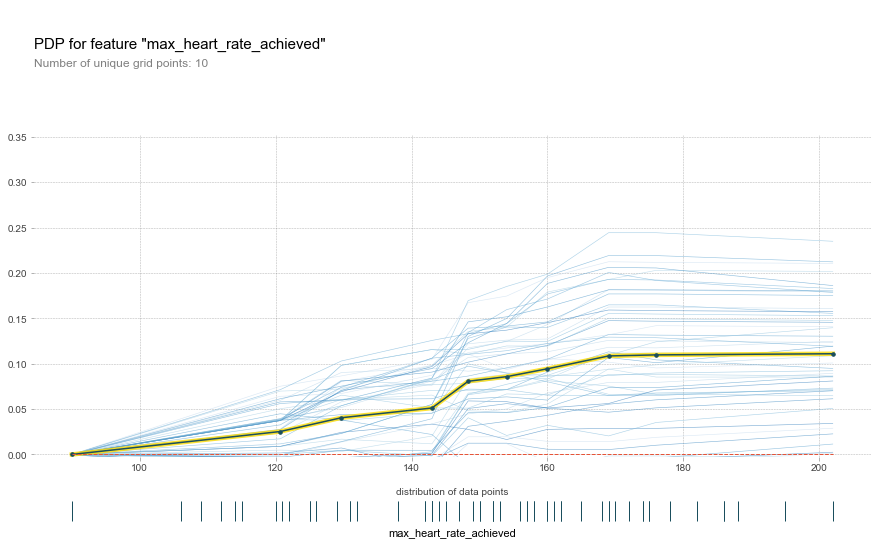

In [616]:
feat_name = 'thalach'
nick_name = "max_heart_rate_achieved"
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, nick_name, plot_lines=True, frac_to_plot=0.8, plot_pts_dist=True)

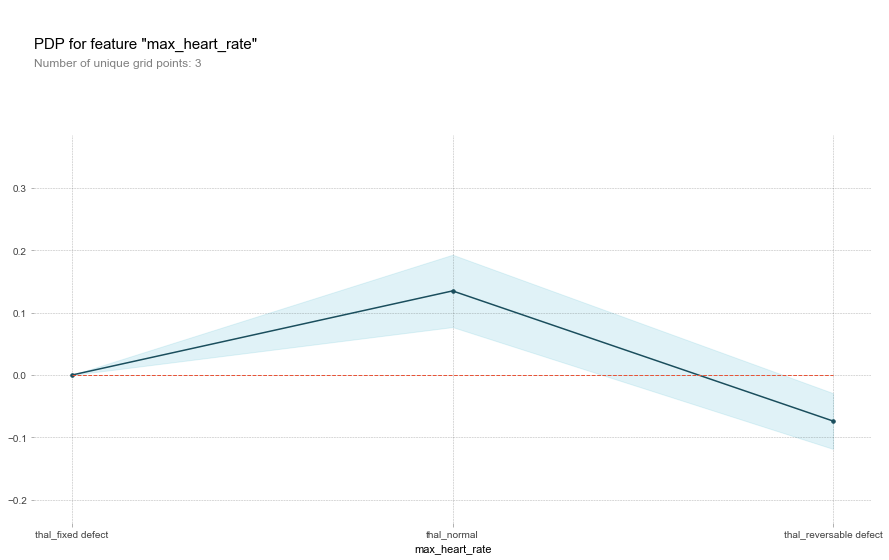

In [617]:
feat_name = ['thal_fixed defect', 'thal_normal', 'thal_reversable defect']
nick_name = "th"
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, 'max_heart_rate')

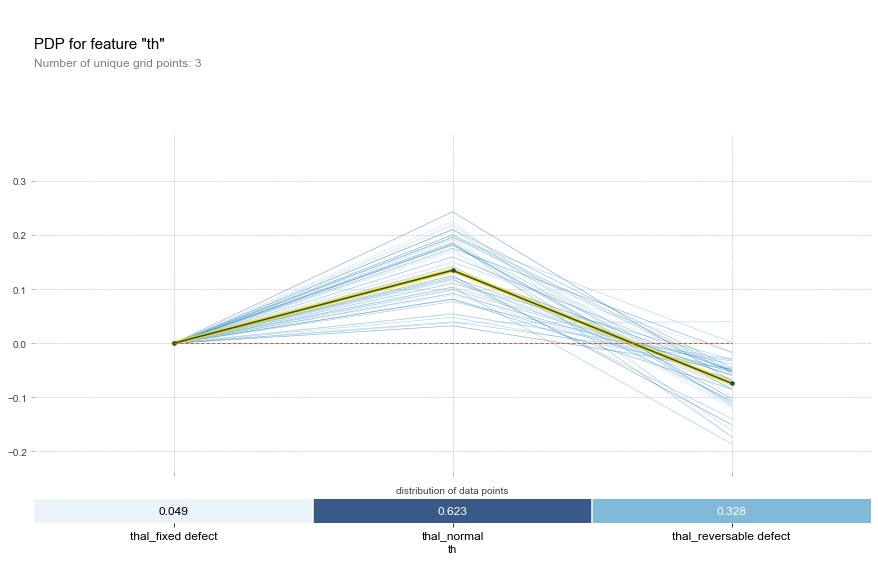

In [618]:
feat_name = ['thal_fixed defect', 'thal_normal', 'thal_reversable defect']
nick_name = "th"
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, nick_name, plot_lines=True, frac_to_plot=0.8, plot_pts_dist=True)

## 4.3 Set of PDP plot(all features)

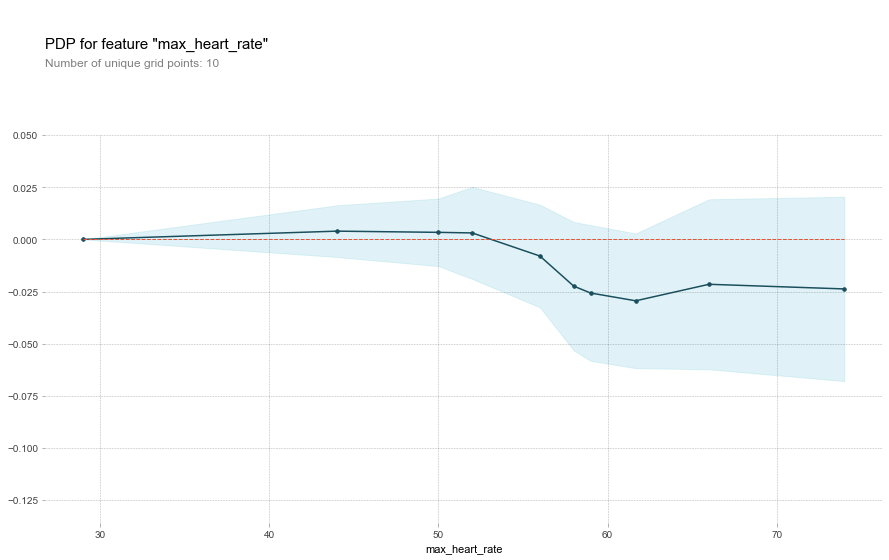

In [619]:
feat_name = 'age'
pdp_dist = pdp.pdp_isolate(
    model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
)
fig, axes = pdp.pdp_plot(pdp_dist, 'max_heart_rate')

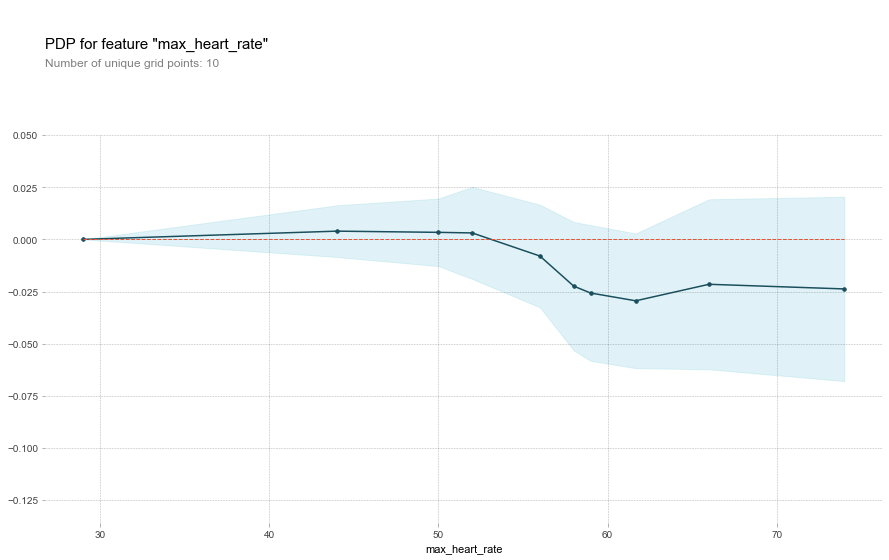

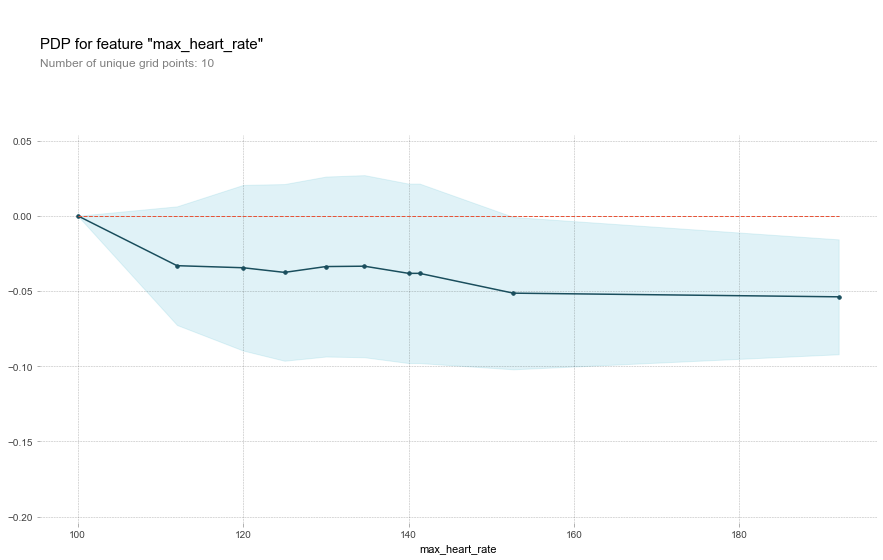

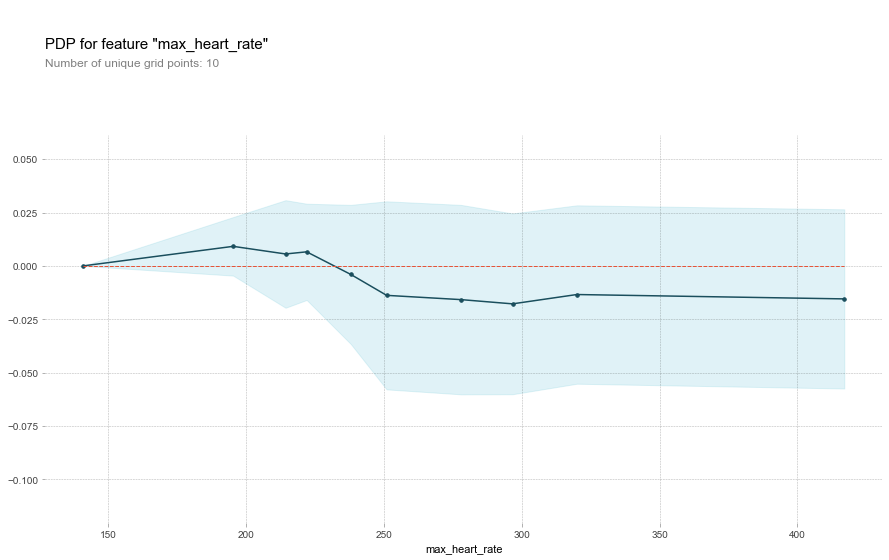

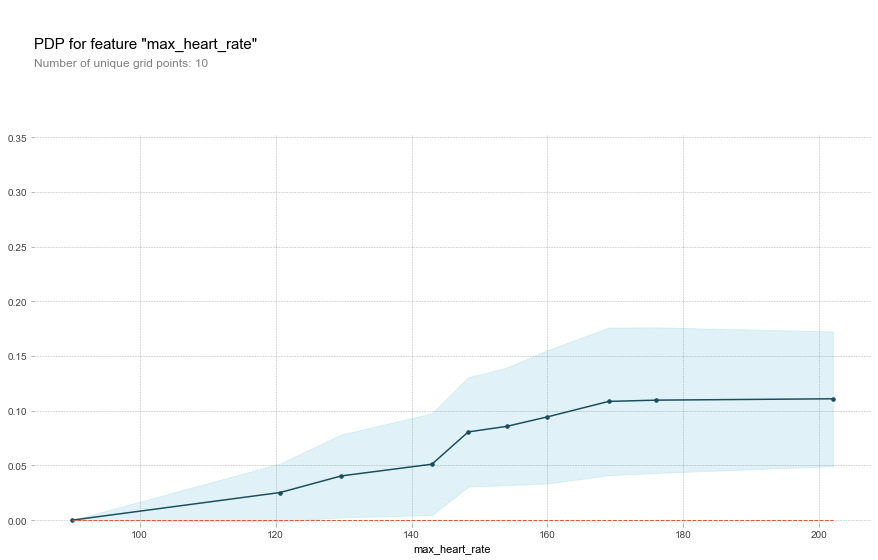

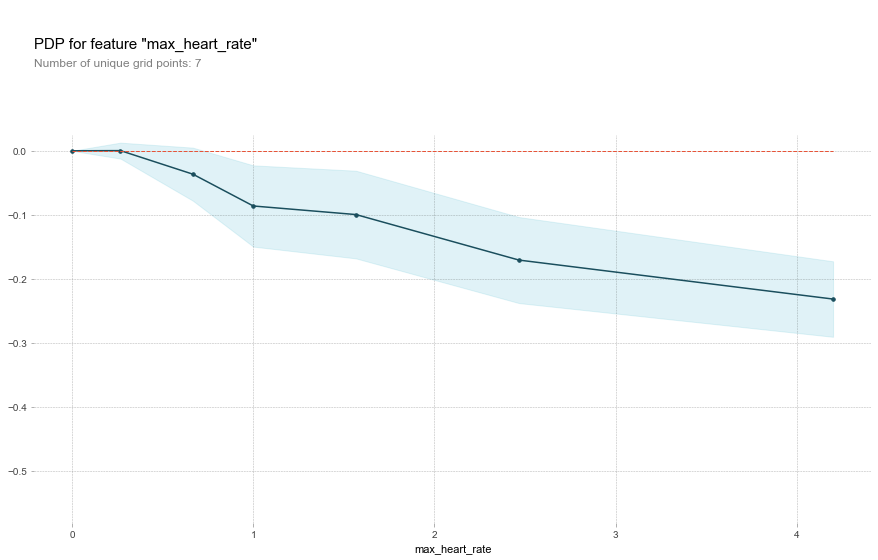

...

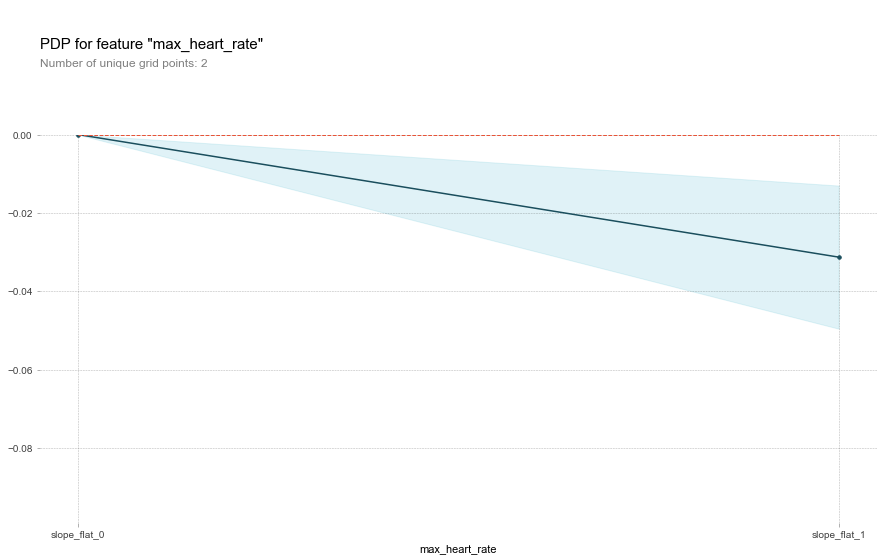

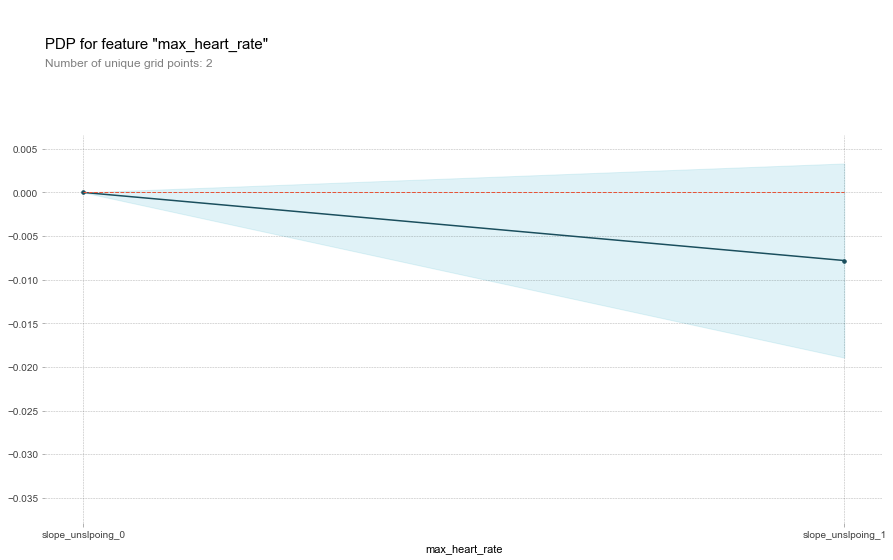

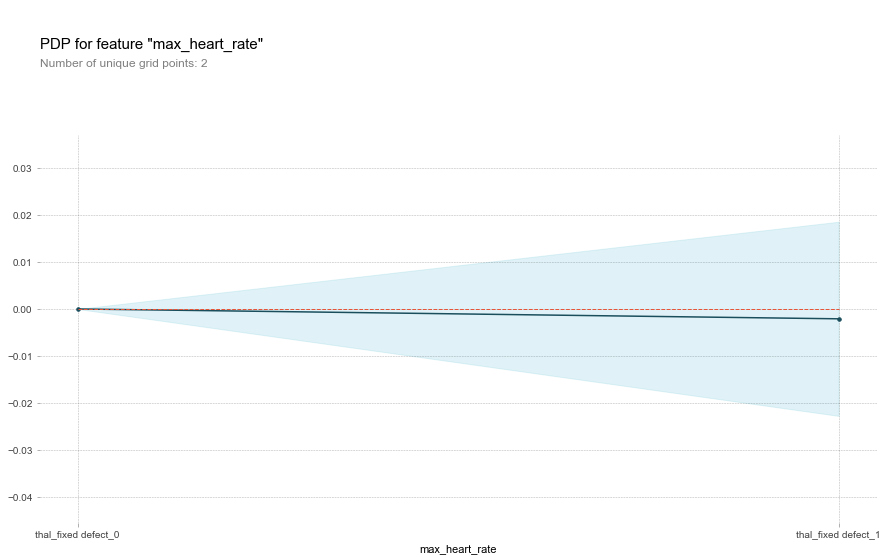

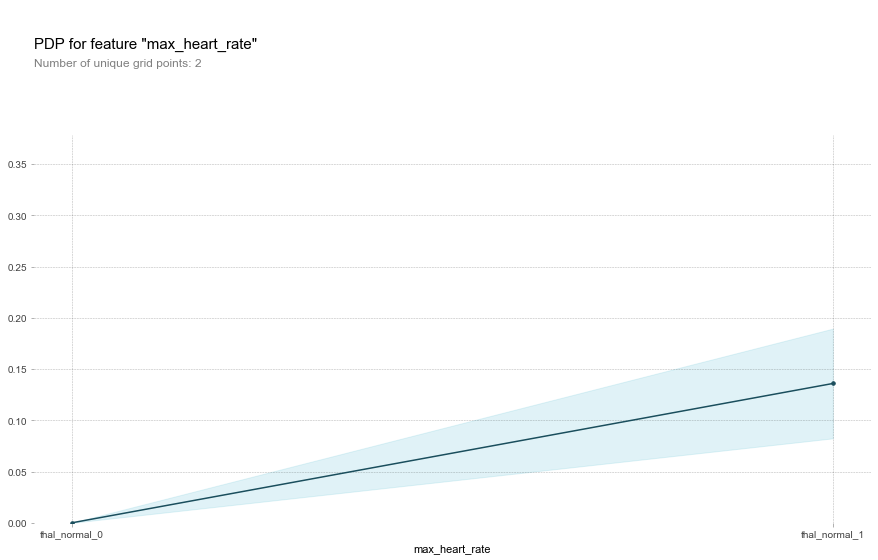

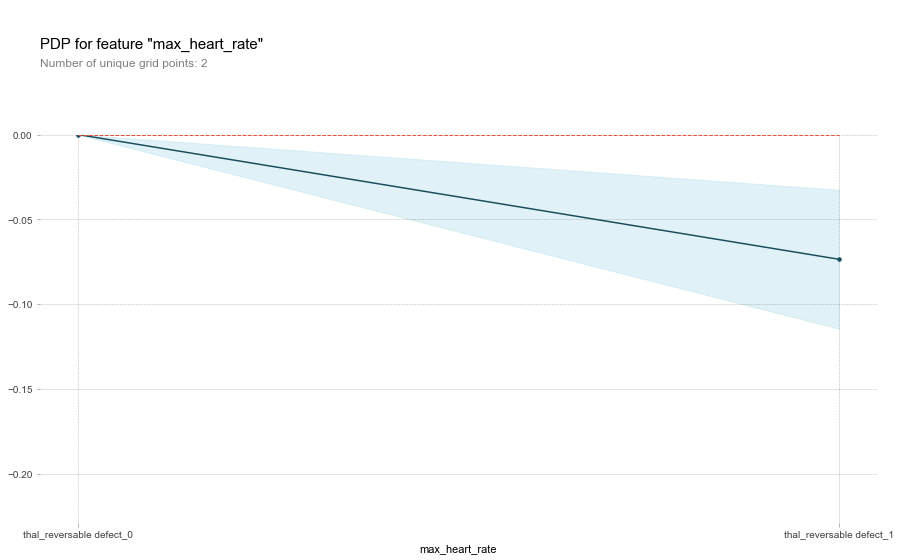

In [620]:
for each in feature_names:
    feat_name = each
    
    pdp_dist = pdp.pdp_isolate(
        model = model, dataset=X_test, model_features= X_test.columns, feature = feat_name
    )
    pdp.pdp_plot(pdp_dist, 'max_heart_rate')
    plt.show()
    


## 4.4 Two  Dimensional PDP Plot: The analysis of interaction relationships between features.

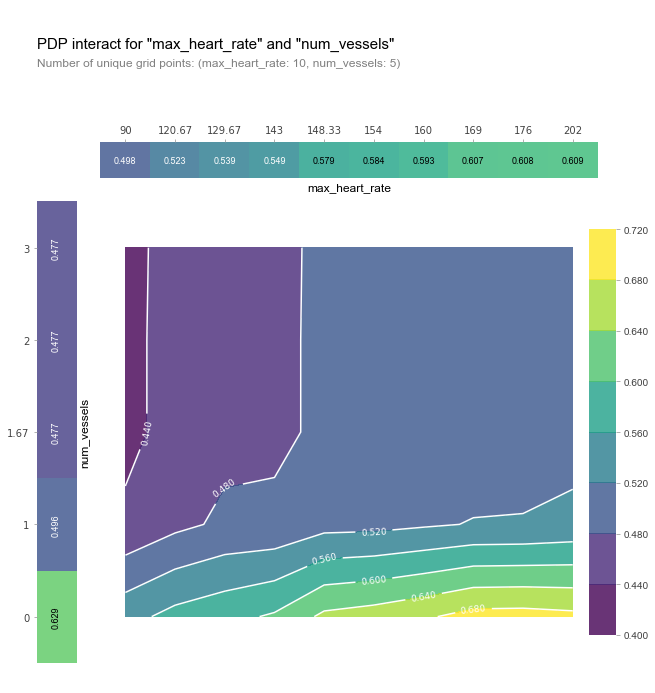

In [621]:
feat_name1 = "thalach"
feat_name2 = 'ca'
nick_name1 = 'max_heart_rate'
nick_name2 = 'num_vessels'
inter1 = pdp.pdp_interact(
    model = model, dataset = X_test, model_features = feature_names, features = [feat_name1,feat_name2])
fig, axes = pdp.pdp_interact_plot(
    pdp_interact_out=inter1, feature_names=[nick_name1, nick_name2], plot_type='contour', x_quantile=True, plot_pdp=True
)

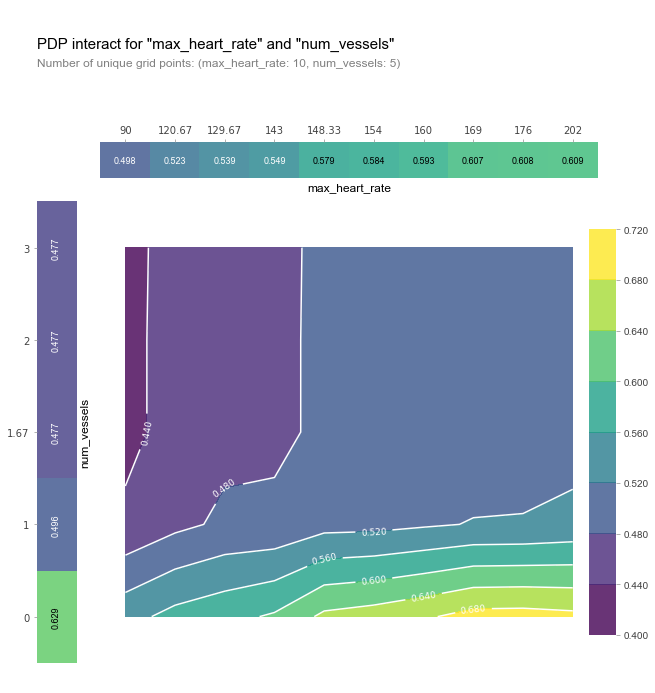

In [622]:
fig, axes = pdp.pdp_interact_plot(
    pdp_interact_out=inter1, feature_names=[nick_name1, nick_name2], plot_type='contour', x_quantile=False, plot_pdp=True
)

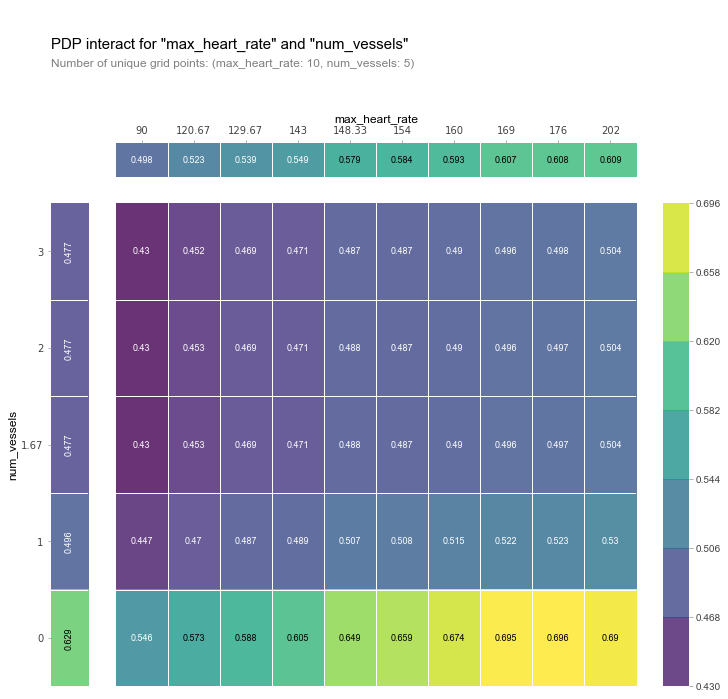

In [623]:
fig, axes = pdp.pdp_interact_plot(
    pdp_interact_out=inter1, feature_names=[nick_name1, nick_name2], plot_type='grid', x_quantile=False, plot_pdp=True
)

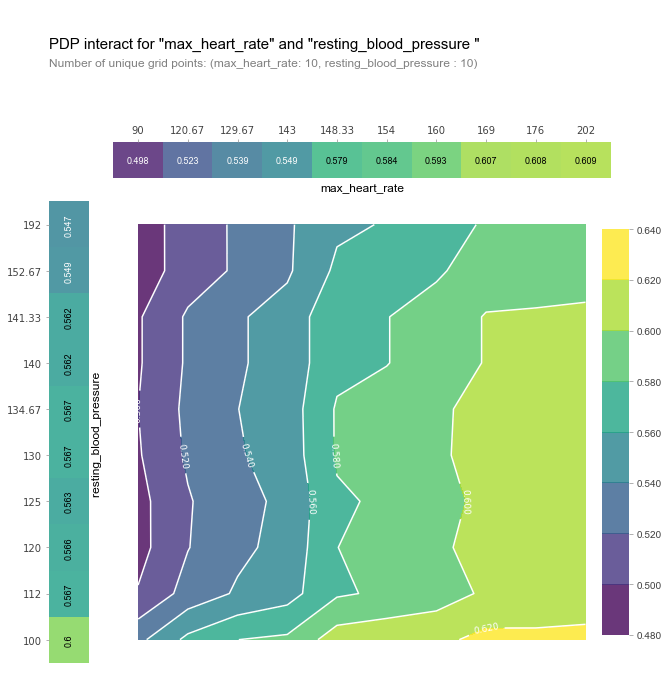

In [624]:
feat_name1 = "thalach"
feat_name2 = 'trestbps'
nick_name1 = 'max_heart_rate'
nick_name2 = 'resting_blood_pressure '
inter1 = pdp.pdp_interact(
    model = model, dataset = X_test, model_features = feature_names, features = [feat_name1,feat_name2])
fig, axes = pdp.pdp_interact_plot(
    pdp_interact_out=inter1, feature_names=[nick_name1, nick_name2], plot_type='contour', x_quantile=True, plot_pdp=True
)

In [629]:
sum(X_test['restecg_ST-T wave abnormality'])

0

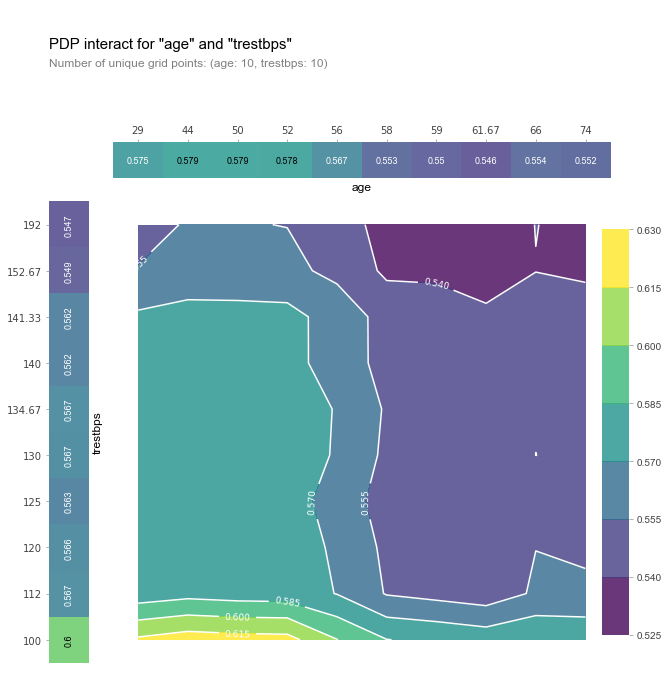

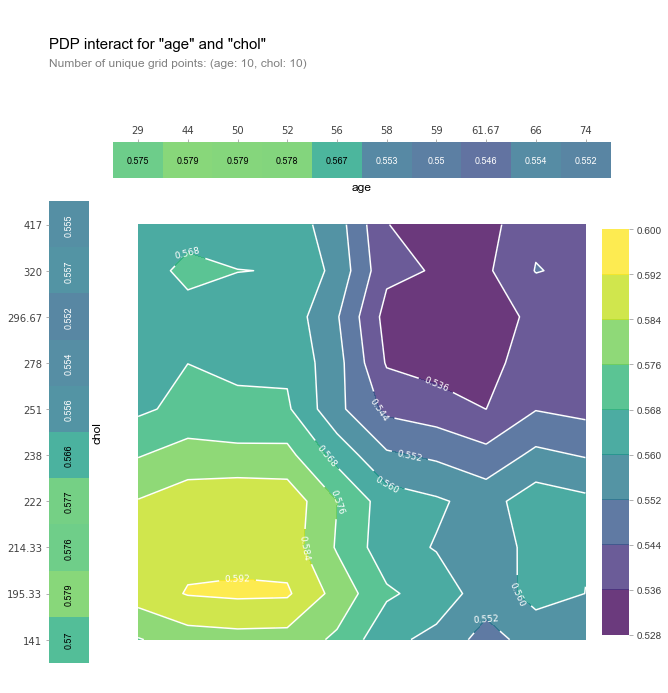

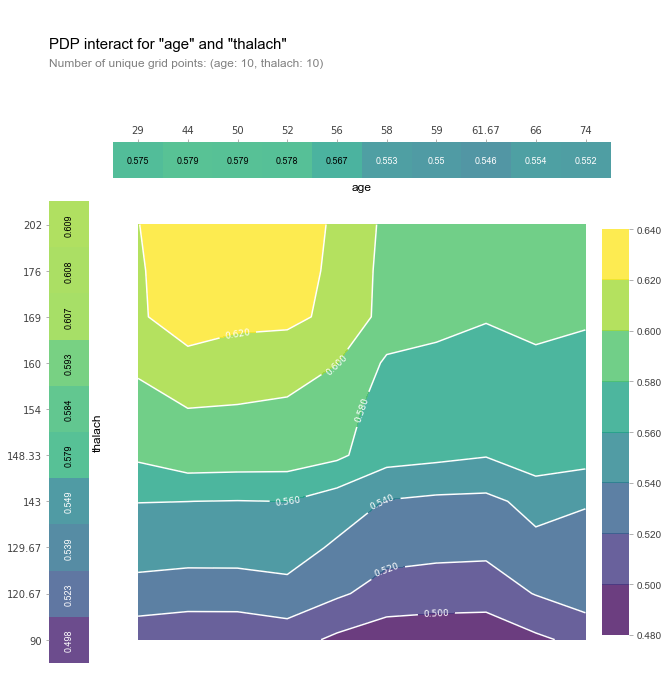

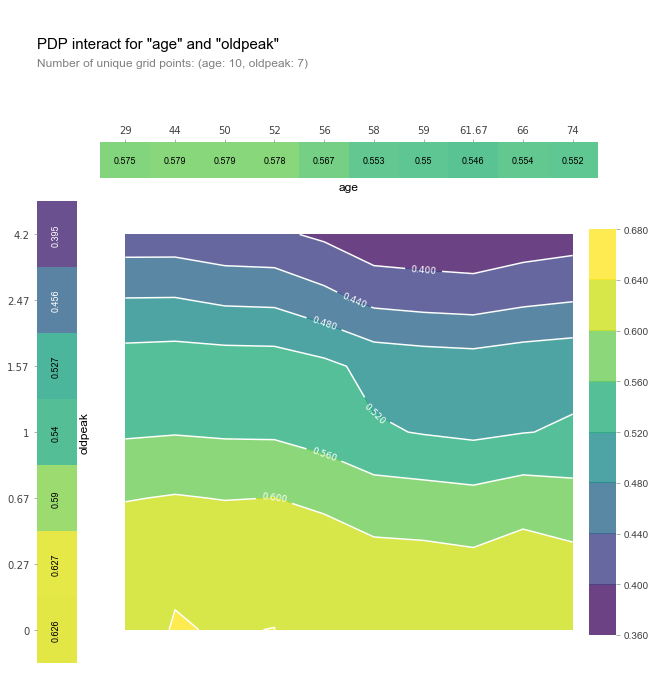

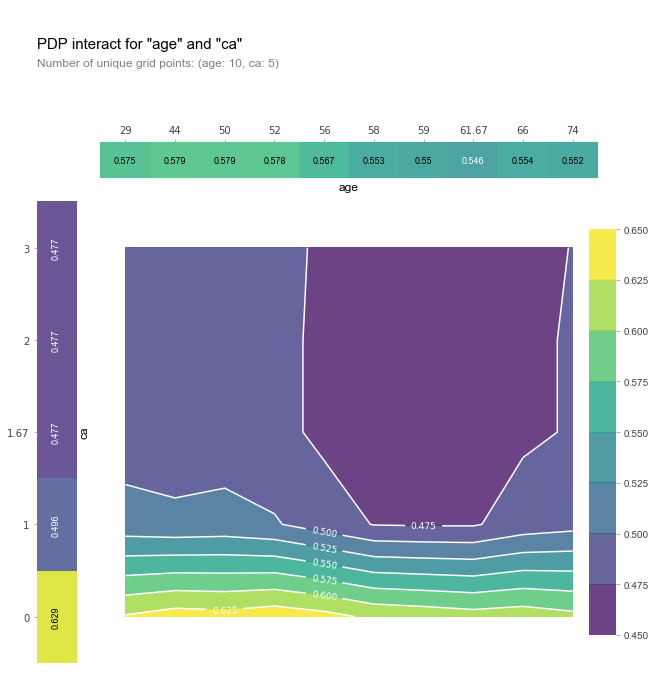

...

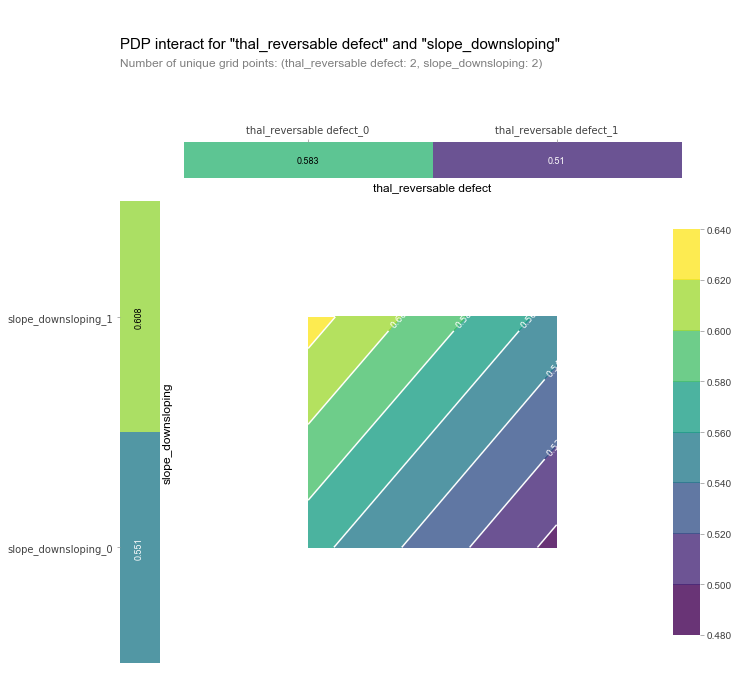

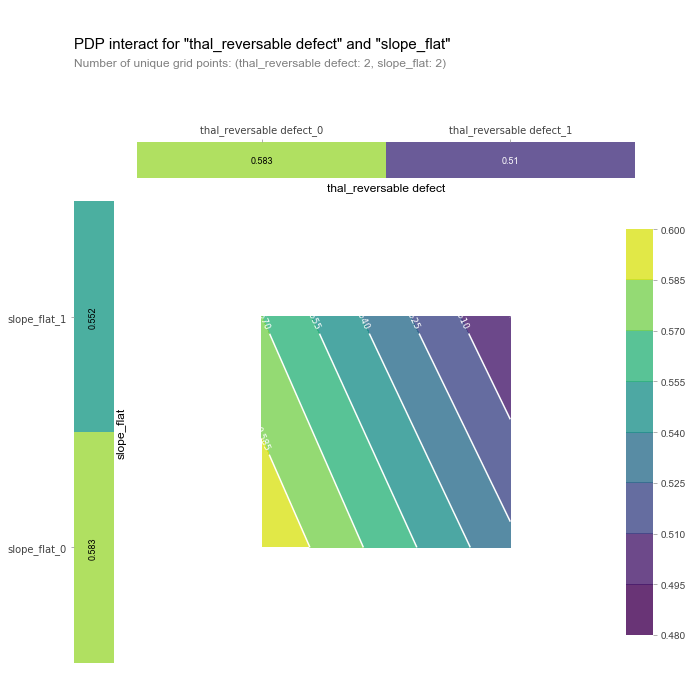

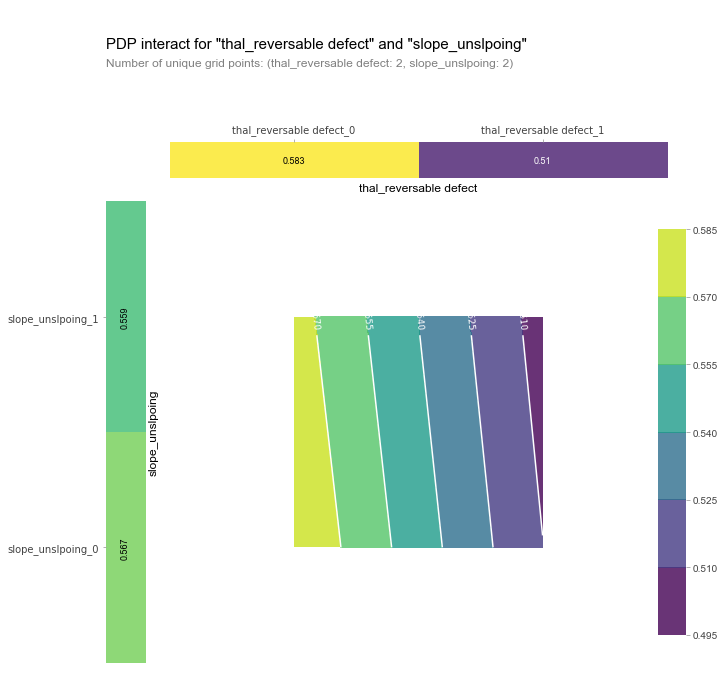

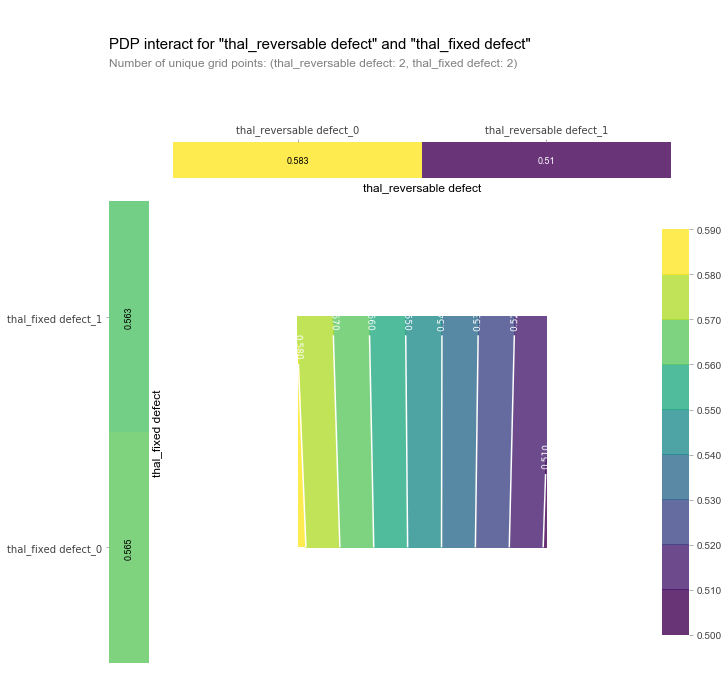

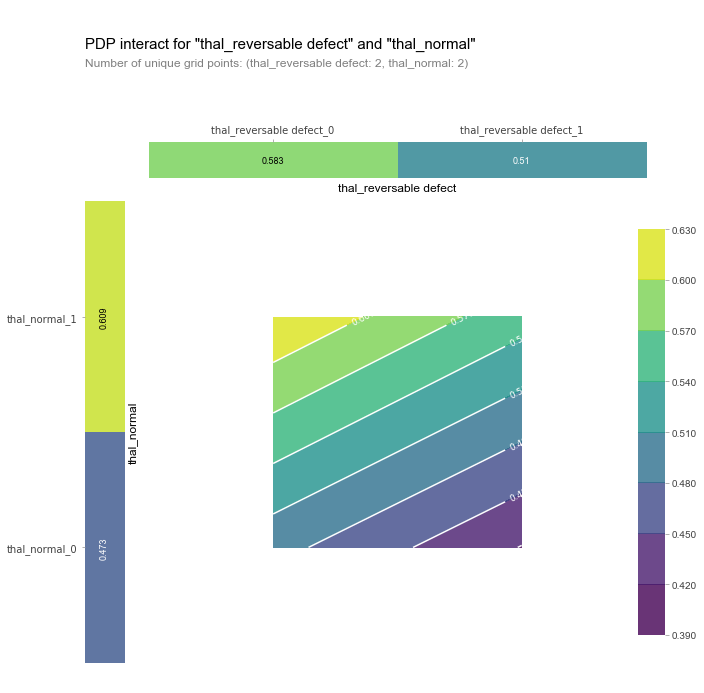

In [626]:
for each1 in feature_names:
    if each1 != 'restecg_ST-T wave abnormality':
        feat_name1 = each1
        nick_name1 = each1
        for each2 in feature_names:
            if each2 != each1 and each2 != 'restecg_ST-T wave abnormality':
                feat_name2 = each2
                nick_name2 = each2
                inter1 = pdp.pdp_interact(
                    model = model, dataset = X_test, model_features = feature_names, features = [feat_name1,feat_name2])
                fig, axes = pdp.pdp_interact_plot(
                    pdp_interact_out=inter1, feature_names=[nick_name1, nick_name2], plot_type='contour', x_quantile=True, plot_pdp=True
                )

# 5 Shape

In [632]:
# !pip install shap
import shap
shap.initjs()

In [691]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)


In [692]:
len(shap_values)

2

In [693]:
# values for the prediction of healthy
shap_values[0].shape 

(61, 25)

In [636]:
# svalues for the prediction of disease
shap_values[1].shape

(61, 25)

In [637]:
shap_values[1]

array([[ 1.47159069e-02, -1.16534005e-02, -2.08298986e-02, ...,
        -8.95440658e-04, -7.98558385e-02, -3.66190311e-02],
       [-1.76960742e-02,  5.39772358e-04,  5.28592859e-03, ...,
        -3.56958607e-04,  6.04793989e-02,  3.71657900e-02],
       [-2.55091195e-02, -7.51402584e-03,  1.51928831e-02, ...,
        -4.14054105e-04,  5.25147731e-02,  1.67928967e-02],
       ...,
       [-2.06808456e-03, -1.24208629e-02, -1.33133187e-02, ...,
         1.43710226e-03, -6.21184178e-02,  2.43280032e-02],
       [-1.52924892e-02,  8.01479161e-03,  6.49104965e-04, ...,
         4.75429045e-04,  7.06577065e-02,  3.46211453e-02],
       [ 8.65960723e-03,  5.95610317e-03,  1.22536812e-02, ...,
         7.01073377e-07,  5.53226464e-02,  2.84094535e-02]])

In [638]:
explainer.expected_value

array([0.43962656, 0.56037344])

In [639]:
explainer.expected_value[0] + explainer.expected_value[1]

1.0000000000000002

In [640]:
shap_values[1].sum(axis = 1).shape

(61,)

In [641]:
y_pred_proba_shap = shap_values[1].sum(axis = 1) + explainer.expected_value[1]

**y_pred_proba_shap is equal to model.predict_proba(X_test)[:, 1]**

In [642]:
y_pred_proba_shap

array([0.22057743, 0.21852031, 0.34679003, 0.05544344, 0.89875759,
       0.0482243 , 0.15306877, 0.76332124, 0.92036266, 0.87139316,
       0.53000428, 0.07131744, 0.21868264, 0.84707853, 0.77441828,
       0.92055775, 0.06827913, 0.97270077, 0.87351498, 0.140058  ,
       0.73188328, 0.56623569, 0.58914508, 0.01170573, 0.46290878,
       0.70446576, 0.80635193, 0.77039258, 0.93922394, 0.05440606,
       0.85129862, 0.93228218, 0.71831931, 0.71675506, 0.06938477,
       0.16651239, 0.9228211 , 0.3214661 , 0.34333925, 0.11343413,
       0.88755397, 0.374284  , 0.9163281 , 0.50814327, 0.82221928,
       0.62789864, 0.63815073, 0.58760894, 0.86643068, 0.48499515,
       0.88378825, 0.94865726, 0.29746857, 0.23652232, 0.14466001,
       0.82050528, 0.89371516, 0.72711422, 0.46941589, 0.7844207 ,
       0.92839816])

In [644]:
model.predict_proba(X_test)[:, 1]

array([0.22057743, 0.21852031, 0.34679003, 0.05544344, 0.89875759,
       0.0482243 , 0.15306877, 0.76332124, 0.92036266, 0.87139316,
       0.53000428, 0.07131744, 0.21868264, 0.84707853, 0.77441828,
       0.92055775, 0.06827913, 0.97270077, 0.87351498, 0.140058  ,
       0.73188328, 0.56623569, 0.58914508, 0.01170573, 0.46290878,
       0.70446576, 0.80635193, 0.77039258, 0.93922394, 0.05440606,
       0.85129862, 0.93228218, 0.71831931, 0.71675506, 0.06938477,
       0.16651239, 0.9228211 , 0.3214661 , 0.34333925, 0.11343413,
       0.88755397, 0.374284  , 0.9163281 , 0.50814327, 0.82221928,
       0.62789864, 0.63815073, 0.58760894, 0.86643068, 0.48499515,
       0.88378825, 0.94865726, 0.29746857, 0.23652232, 0.14466001,
       0.82050528, 0.89371516, 0.72711422, 0.46941589, 0.7844207 ,
       0.92839816])

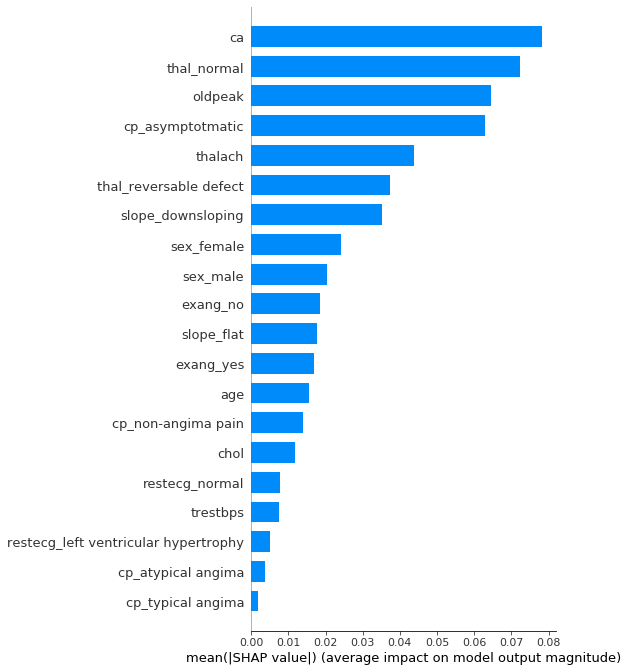

In [645]:
shap.summary_plot(shap_values[1], X_test, plot_type="bar")

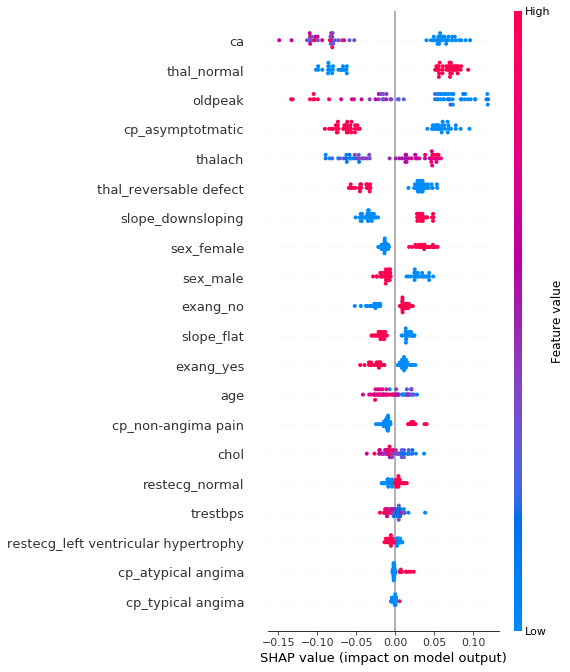

In [646]:
shap.summary_plot(shap_values[1], X_test)

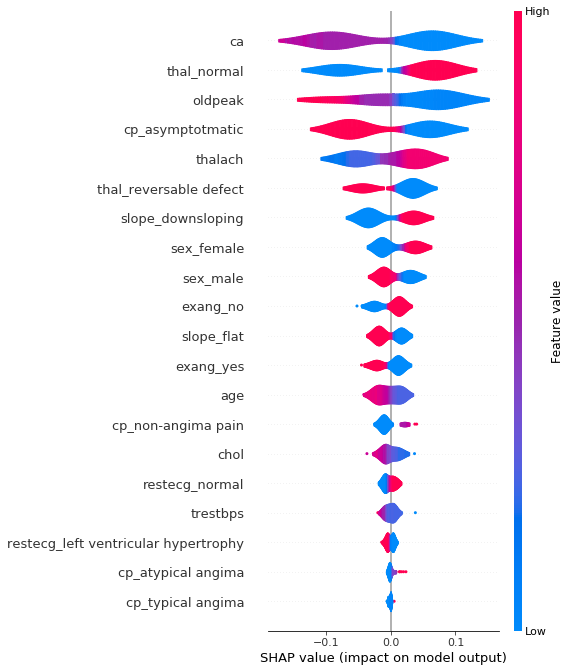

In [647]:
shap.summary_plot(shap_values[1], X_test, plot_type="violin")

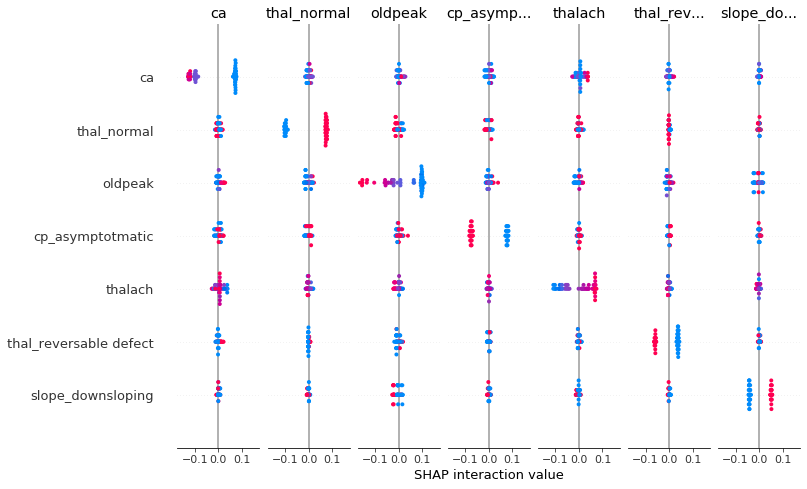

In [648]:
shap_interaction_values = explainer.shap_interaction_values(X_test)
shap.summary_plot(shap_interaction_values[1], X_test)

**Analyzing the impact of each feature on predicting the result of getting disease for an individual sample.**

In [653]:
idx = 204
patient = X.iloc[idx, :]

In [654]:
patient

age                                      45.0
trestbps                                142.0
chol                                    309.0
thalach                                 147.0
oldpeak                                   0.0
ca                                        3.0
sex_female                                0.0
sex_male                                  1.0
cp_asymptotmatic                          1.0
cp_atypical angima                        0.0
cp_non-angima pain                        0.0
cp_typical angima                         0.0
fbs_greater than 120mg/ml                 0.0
fbs_lower than 120mg/ml                   1.0
restecg_ST-T wave abnormality             0.0
restecg_left ventricular hypertrophy      1.0
restecg_normal                            0.0
exang_no                                  0.0
exang_yes                                 1.0
slope_downsloping                         0.0
slope_flat                                1.0
slope_unslpoing                   

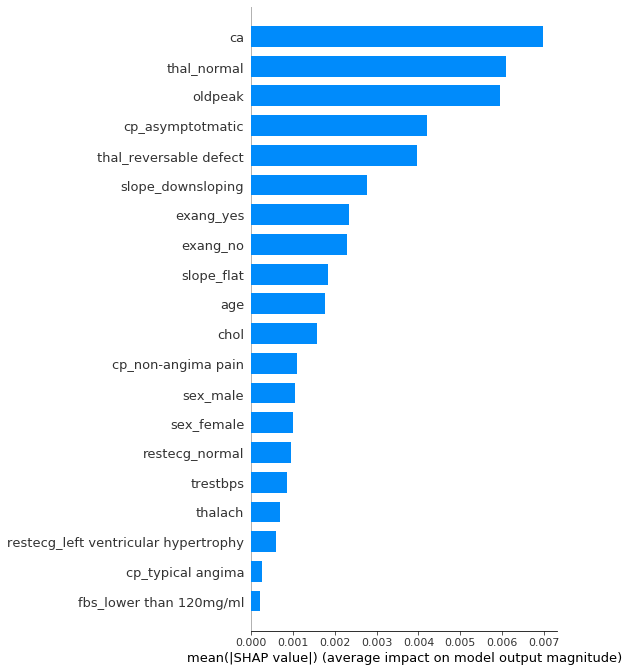

In [655]:
#patient 204 is the first patient in X_test
shap.summary_plot(shap_interaction_values[1][0], X_test, plot_type="bar")

In [656]:
shap_values_patient = explainer.shap_values(patient)

In [657]:
shap_values_patient

[array([-1.47159069e-02,  1.16534005e-02,  2.08298986e-02,  7.34614050e-03,
        -1.18346695e-01,  1.03750533e-01,  1.54833093e-02,  9.06049096e-03,
         7.27790922e-02,  2.15068497e-03,  1.47496943e-02,  2.36042134e-03,
        -4.00328961e-04, -3.27167385e-04, -4.09636358e-05,  2.78754813e-03,
         1.56321653e-02,  2.56537996e-02,  1.93082848e-02,  2.21655044e-02,
         1.07440554e-02, -1.98253857e-04,  8.95440658e-04,  7.98558385e-02,
         3.66190311e-02]),
 array([ 1.47159069e-02, -1.16534005e-02, -2.08298986e-02, -7.34614050e-03,
         1.18346695e-01, -1.03750533e-01, -1.54833093e-02, -9.06049096e-03,
        -7.27790922e-02, -2.15068497e-03, -1.47496943e-02, -2.36042134e-03,
         4.00328961e-04,  3.27167385e-04,  4.09636358e-05, -2.78754813e-03,
        -1.56321653e-02, -2.56537996e-02, -1.93082848e-02, -2.21655044e-02,
        -1.07440554e-02,  1.98253857e-04, -8.95440658e-04, -7.98558385e-02,
        -3.66190311e-02])]

In [658]:
shap_values_patient[0]

array([-1.47159069e-02,  1.16534005e-02,  2.08298986e-02,  7.34614050e-03,
       -1.18346695e-01,  1.03750533e-01,  1.54833093e-02,  9.06049096e-03,
        7.27790922e-02,  2.15068497e-03,  1.47496943e-02,  2.36042134e-03,
       -4.00328961e-04, -3.27167385e-04, -4.09636358e-05,  2.78754813e-03,
        1.56321653e-02,  2.56537996e-02,  1.93082848e-02,  2.21655044e-02,
        1.07440554e-02, -1.98253857e-04,  8.95440658e-04,  7.98558385e-02,
        3.66190311e-02])

In [659]:
shap_values_patient[1]

array([ 1.47159069e-02, -1.16534005e-02, -2.08298986e-02, -7.34614050e-03,
        1.18346695e-01, -1.03750533e-01, -1.54833093e-02, -9.06049096e-03,
       -7.27790922e-02, -2.15068497e-03, -1.47496943e-02, -2.36042134e-03,
        4.00328961e-04,  3.27167385e-04,  4.09636358e-05, -2.78754813e-03,
       -1.56321653e-02, -2.56537996e-02, -1.93082848e-02, -2.21655044e-02,
       -1.07440554e-02,  1.98253857e-04, -8.95440658e-04, -7.98558385e-02,
       -3.66190311e-02])

In [660]:
shap_values_patient[0] + shap_values_patient[1]

array([-1.38777878e-17,  2.25514052e-17, -3.46944695e-18,  1.56125113e-17,
       -1.38777878e-17,  1.52655666e-16,  3.46944695e-18, -3.46944695e-18,
        0.00000000e+00,  4.33680869e-19, -1.73472348e-18,  4.33680869e-19,
        1.08420217e-19,  0.00000000e+00,  2.03287907e-20,  1.30104261e-18,
        1.73472348e-17, -6.93889390e-18, -1.04083409e-17,  6.93889390e-18,
       -6.93889390e-18,  1.35525272e-19,  0.00000000e+00, -1.94289029e-16,
        2.77555756e-17])

In [661]:
shap.force_plot(explainer.expected_value[1], shap_values_patient[1], patient)

**Force plot displays the contribution of each feature to the prediction of getting disease for patient 126.**

**Red represents positive contribution and blue represents negative contribution in the force plot. The longer the plot, the higher the SHAP value, which means the greater the impact of the feature.**

In [674]:
#Complete Code
idx = 126
patient = X.iloc[idx, :]
patient_df = X.loc[idx:idx]
model_predict_proba = model.predict_proba(patient_df)[0][1]
print('The true label of {} patient is {}, the model prediction is {:.2f}'.format(idx, bool(y_test[idx]), model_predict_proba))

shap_values_patient = explainer.shap_values(patient)
shap.force_plot(explainer.expected_value[1], shap_values_patient[1], patient)

The true label of 126 patient is False, the model prediction is 0.06


In [686]:
number_show = 60
shap_values_summary = explainer.shap_values(X_train.iloc[:number_show])
shap.force_plot(explainer.expected_value[1], shap_values_summary[1], X_test.iloc[:number_show])

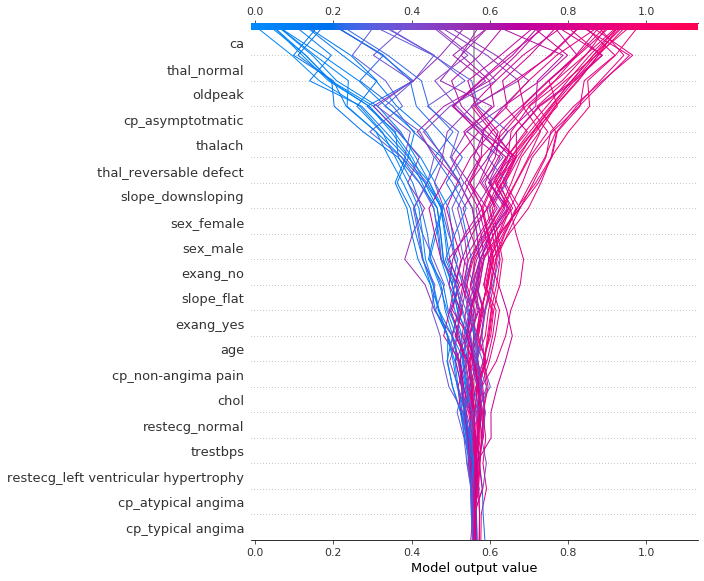

In [696]:
shap_values = explainer.shap_values(X_test)
shap.decision_plot(explainer.expected_value[1], shap_values[1], X_test)

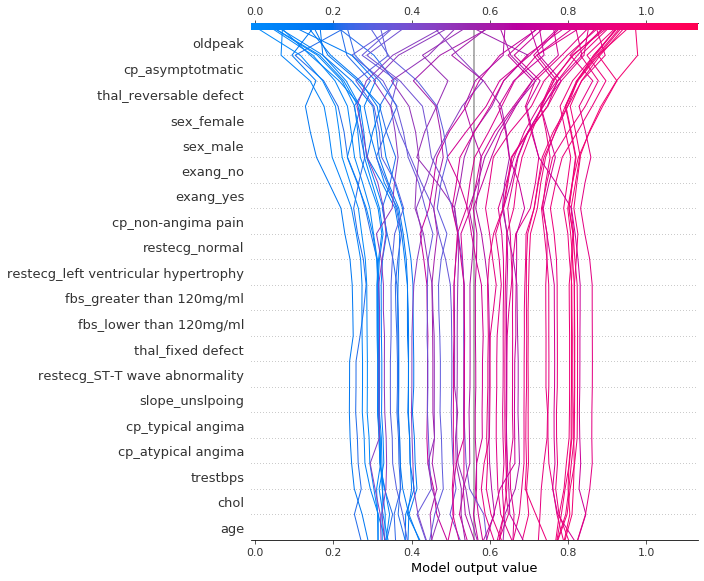

In [697]:
shap.decision_plot(explainer.expected_value[1], shap_values[1], X_test, feature_order = 'hclust')

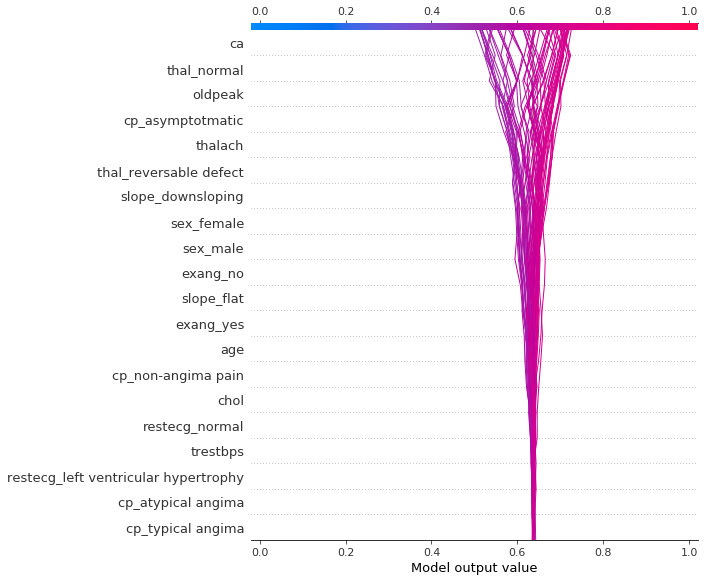

In [698]:
shap.decision_plot(explainer.expected_value[1], shap_values[1], X_test, link = 'logit')

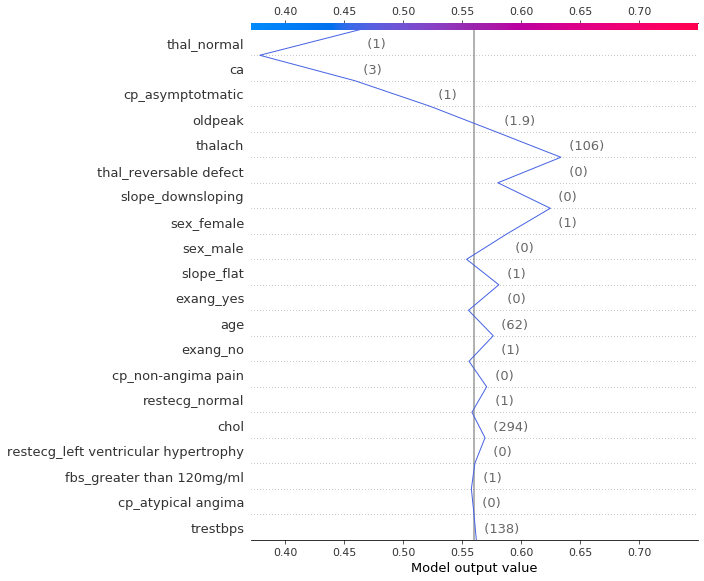

In [700]:
idx = 24
selection = np.zeros((61))
selection[idx] = 1
selection = selection > 0
shap.decision_plot(explainer.expected_value[1], shap_values[1][selection], X_test[selection])

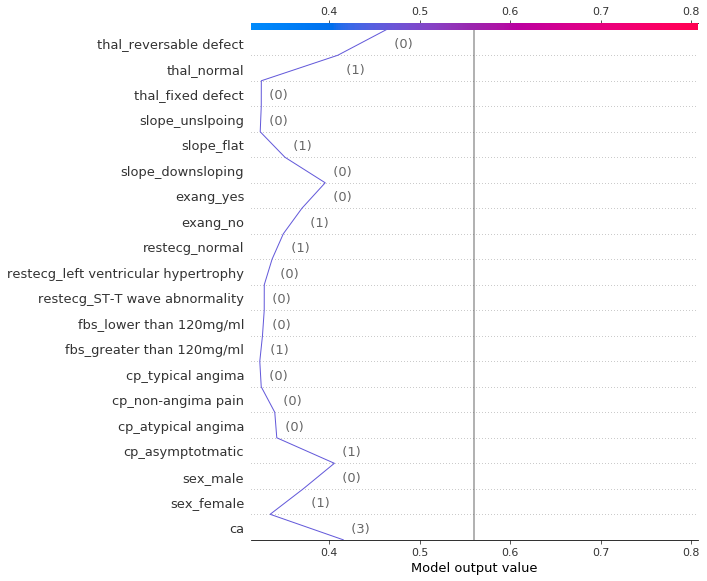

In [702]:
feature_idx = [i for i in range(25)]
shap.decision_plot(explainer.expected_value[1], shap_values[1][selection], X_test[selection], feature_order = feature_idx)

In [703]:
misclassified = y_pred != y_test
misclassified_df = pd.DataFrame({'misclassified':misclassified})

In [704]:
misclassified_df

,misclassified
204,False
154,False
228,False
126,False
183,True
...,...
276,False
121,False
186,False
300,True


In [706]:
misclassified_df = misclassified_df[misclassified_df['misclassified'] == True]

In [707]:
misclassified_df

,misclassified
183,True
260,True
171,True
43,True
187,True
56,True
300,True


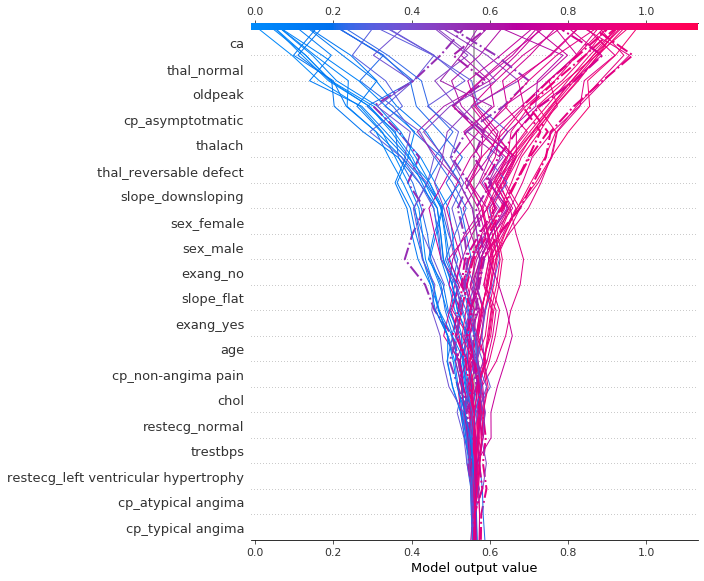

In [708]:
shap.decision_plot(explainer.expected_value[1], shap_values[1], X_test, highlight=misclassified)

In [709]:
shap_interaction_values = explainer.shap_interaction_values(X_test)

In [711]:
shap_interaction_values[0].shape

(61, 25, 25)

In [712]:
shap_interaction_values[1].shape

(61, 25, 25)

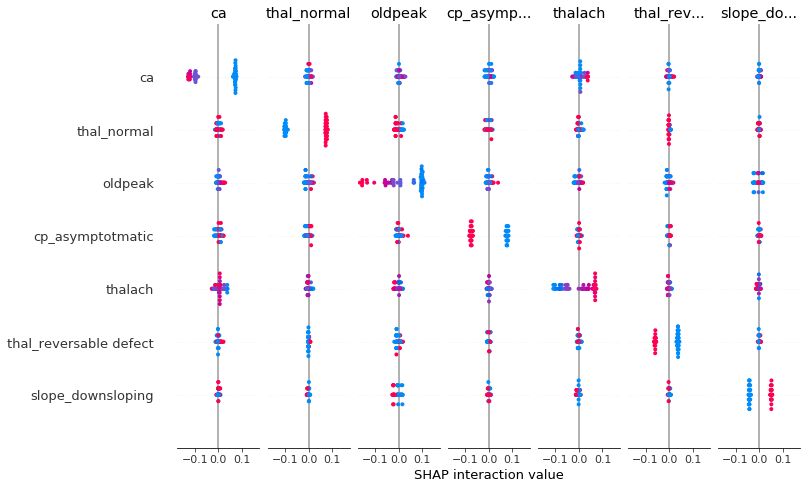

In [713]:
shap.summary_plot(shap_interaction_values[1], X_test)

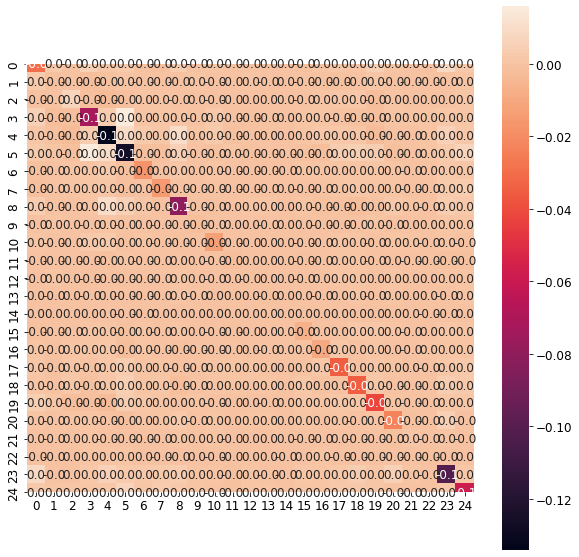

In [714]:
idx = 5
plt.figure(figsize=(10,10))
sns.heatmap(shap_interaction_values[1][idx],annot=True,fmt='.1f',square=True)
plt.show()